# Blueprint mapping notebook
### 4 main sections:
#### 1. KL divergence with neonatal development
#### 2. KL divergence across ontogeny and phylogeny
#### 3. KL divergence in preterms vs full-terms
#### 4. Spectral embedding across ontogeny and phylogeny

##### Citation: Warrington*, Thompson*, Bastiani, Dubois, Baxter, Slater, Jbabdi, Mars, Sotiropoulos (bioRxiv), "Concurrent mapping of brain ontogeny and phylogeny within a common space"
##### Corresponding author: Shaun Warrington, shaun.warrington1@nottingham.ac.uk; Stamatios Sotiropoulos, Stamatios.Sotiropoulos@nottingham.ac.uk

In [1]:
import numpy as np
import nibabel as nib
from nibabel import cifti2
from numpy import matlib
import pandas as pd
import scipy

import seaborn as sns
import matplotlib 
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from surfplot import Plot
from adjustText import adjust_text
from matplotlib.ticker import FormatStrFormatter

import subprocess

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

## define functions

In [2]:
# save data as CIFTI file
def data_to_cifti(data, fname, roi_left, roi_right=None):
    
    if data.ndim==1:
        data=np.expand_dims(data, axis=0)
    
    n,ctx=data.shape
    
    #set up cifti brain model axes
    bm_ctx_left = cifti2.BrainModelAxis.from_mask(roi_left, name="CortexLeft")
    
    if roi_right is not None:
        bm_ctx_right = cifti2.BrainModelAxis.from_mask(roi_right, name="CortexRight")
        bm = bm_ctx_left + bm_ctx_right 
        
    else :bm = bm_ctx_left
    sc = cifti2.ScalarAxis(np.arange(n).astype("str"))

    #save cifti
    hdr = cifti2.Cifti2Header.from_axes((sc,bm))
    img = cifti2.Cifti2Image(data, hdr)

    nib.save(img, fname)

In [3]:
# Calculate KL divergence
def KLD(A,B):

    A[np.isnan(A)] = 0
    B[np.isnan(B)] = 0
    Amask = A!=0
    Bmask = B!=0

    D = np.dot(A*np.log2(A+(A==0)), Bmask.T) - np.dot(A, (Bmask*np.log2(B+(B==0))).T)+ np.dot(Amask, (B*np.log2(B+(B==0))).T) - np.dot((Amask*np.log2(A+(A==0))), B.T)
    return D


In [4]:
# Remove contralateral tract data
def remove_contra(bp, tracts, n_left):
    tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))
    
    bp_new = np.zeros((len(tract_names),bp.shape[1]))

    for i, t in enumerate(tracts):
        new_i = tract_names.index(t.split("_")[0])
        if len(t.split("_")) == 1:
            bp_new[new_i,:] = bp[i,:]
        
        elif t.split("_")[1] == "l":
            bp_new[new_i, :n_left] = bp[i, :n_left]
        
        elif t.split("_")[1] == "r":
            bp_new[new_i, n_left:] = bp[i, n_left:]
    
    #normalise
    #bp_new = bp_new / np.sum(bp_new, axis=0)
    
    return bp_new

In [5]:
# find the tract contribution at a particular vertex
def ctx2cifti(ctx_index, hemi, roi_l, roi_r, bp):
    
    idx = np.append(np.cumsum(roi_l)*roi_l, np.cumsum(roi_r)*roi_r+np.sum(roi_l))
    if hemi=="l":
        cifti_index = idx[ctx_index].astype(int)
    
    elif hemi=="r":
        cifti_index = idx[ctx_index + len(roi_l)].astype(int)

    plt.xticks(rotation=45, size="xx-small")
    plt.plot(tract_names,bp[:,cifti_index],marker=".")
    ax = plt.gca()
    ax.grid(axis='x')
    return cifti_index

In [6]:
# parcellate some data
# outputs median data across parcels in original data dimensions, parcel labels, and the averaged data in reduced form
def parc_data(parc, data, blueprint=False):
    if np.ndim(data)==1:
        data=np.expand_dims(data,0)
    
    labels={}
    data_parcellated = np.zeros_like(data)
    
    parc_values = parc.get_fdata()[0]
    
    cifti_hdr = parc.header
    label_axis = cifti_hdr.get_axis(0)
    label_dict = label_axis.get_element(0)[1]
    
    data_reduced = np.zeros((np.shape(data)[0], len(label_dict)))
    
    for i, l in enumerate(label_dict):
        mask = (parc_values == l)
        labels[l] = label_dict[l][0]#.split('_')[-1]
        
        for n, vals in enumerate(data):
            parcel_average = np.nanmedian(vals[mask])
            data_parcellated[n,mask] = parcel_average
            data_reduced[n, i] = parcel_average
    
    #normalise results, if blueprint flag used
    if blueprint==True:
        data_parcellated = data_parcellated / np.sum(data_parcellated, axis=0)
        data_reduced = data_reduced / np.sum(data_reduced, axis=0)
    
    return data_parcellated, labels, data_reduced

In [7]:
#returns parcellated results in correct format to be saved as ciftis for visualisation
#data must have same number of values as label list
def return_parc_data(orig_parc, data, label_list):
    #get labels from parcellation
    cifti_hdr = orig_parc.header
    label_axis = cifti_hdr.get_axis(0)
    label_dict = label_axis.get_element(0)[1]
    labels={}
    for i, l in enumerate(label_dict):
        labels[l] = label_dict[l][0]
        
    orig_parc = orig_parc.get_fdata()[0]
    parc_temp = np.zeros_like(orig_parc)
    
    i=0
    for key in labels:
        value = labels[key]
        if value in label_list:
            mask = (orig_parc == key)
            parc_temp[mask] = data[i]
            i+=1
            
    return parc_temp

In [8]:
# mask parcels out from dense blueprint
def mask_parc_from_dense(parc, data, lab, mac=False):
    parc_values = parc.get_fdata()[0]
    cifti_hdr = parc.header
    label_axis = cifti_hdr.get_axis(0)
    label_dict = label_axis.get_element(0)[1]

    def matchingKeys(dictionary, searchString):
        return [key for key,val in dictionary.items() if any(searchString in s for s in val)]
    
    for l in lab:
        mask = (parc_values == matchingKeys(label_dict, l)[0])
        if mac == True:
            mask = np.hstack((mask,np.zeros((data.shape[1]-parc_values.shape[0],), dtype=bool)))
            
        data[:,mask] = 0
    
    return data

In [9]:
# get parcel-wise connectivity profiles
def get_parc_profile(parc, data, lab):
    parc_values = parc.get_fdata()[0]
    cifti_hdr = parc.header
    label_axis = cifti_hdr.get_axis(0)
    label_dict = label_axis.get_element(0)[1]

    def matchingKeys(dictionary, searchString):
        return [key for key,val in dictionary.items() if any(searchString in s for s in val)]

    mask = (parc_values == matchingKeys(label_dict, lab)[0])
    profile = np.nanmean(data[:,mask], axis=1)
    
    return profile

In [10]:
# get parcel label for all vertices in parcel
def dense_parc_labels(parc):
    parc_values = parc.get_fdata()[0]
    cifti_hdr = parc.header
    label_axis = cifti_hdr.get_axis(0)
    label_dict = label_axis.get_element(0)[1]

    dense_labs = np.empty(parc_values.shape[0], dtype=object)
    for key in label_dict:
        mask = (parc_values == key)
        dense_labs[mask] = label_dict[key][0]
    
    return dense_labs

In [11]:
# simply abbreviate FS labels for plotting
def abbrv_labs(lab_df, keyword):
    out_df = lab_df.copy()
    out_df["OLD_NAME"] = out_df[keyword]
    out_df[keyword] = out_df[keyword].map(lambda x: x.lstrip('L_'))
    out_df[keyword] = out_df[keyword].str.replace('cingulate', 'cing')
    out_df[keyword] = out_df[keyword].str.replace('frontal', 'front')
    out_df[keyword] = out_df[keyword].str.replace('medial', 'med')
    out_df[keyword] = out_df[keyword].str.replace('temporal', 'temp')
    out_df[keyword] = out_df[keyword].str.replace('transverse', 'trans')
    out_df[keyword] = out_df[keyword].str.replace('middle', 'mid')
    out_df[keyword] = out_df[keyword].str.replace('superior', 'sup')
    out_df[keyword] = out_df[keyword].str.replace('inferior', 'inf')
    out_df[keyword] = out_df[keyword].str.replace('lateral', 'lat')
    out_df[keyword] = out_df[keyword].str.replace('anterior', 'ant')
    out_df[keyword] = out_df[keyword].str.replace('posterior', 'post')
    return out_df

# load neonate age-group data
def load_age_bp(group):
    group_bp = nib.load(f"{data_dir}/ave_neo_{group}.LR.dscalar.nii")
    group_bp = np.asanyarray(group_bp.dataobj)
    group_bp = group_bp[:,neo_mask==1]
    group_bp = remove_contra(group_bp, tracts, neo_n_left)
    group_bp = group_bp / np.sum(group_bp, axis=0)
    group_bp = mask_parc_from_dense(neo_parc, group_bp, fs_mask_out)
    return group_bp


In [12]:
# parcellate a map using the DK parcellation, remove unwanted parcels, get the lable list back
def prep_dk(parc, data, blueprint=True):
    bp_parc, foo, bp_avparcl = parc_data(parc, data, blueprint=False) #without normalisation, to normalise left hemi separately
    lab_list = list(foo.values())

    # remove right hemi parcels
    ind_rm = [i for i, l in enumerate(lab_list) if 'R_' in l]
    bp_avparcl = np.delete(bp_avparcl, [ind_rm], 1)
    for i in sorted(ind_rm, reverse=True):
        del lab_list[i]

    # and ??? parcel
    ind_rm = [i for i, l in enumerate(lab_list) if '???' in l]
    bp_avparcl = np.delete(bp_avparcl, [ind_rm], 1)
    for i in sorted(ind_rm, reverse=True):
        del lab_list[i]

    # and any bad parcels
    idx = [lab_list.index(key) for key in fs_rm if key in lab_list]
    bp_avparcl = np.delete(bp_avparcl, idx, axis=1)
    for b in fs_rm:
        if b in lab_list:
            lab_list.remove(b)  
    
    if blueprint == True:
        #normalise
        bp_parc = bp_parc/np.sum(bp_parc, axis=0)
        bp_avparcl = bp_avparcl/np.sum(bp_avparcl, axis=0)
    
    # get label dictionary
    lab_dict = fs_label_dict.loc[fs_label_dict['NAME'].isin(lab_list)]

    return bp_parc, bp_avparcl, lab_dict, lab_list

# as above but with Brodmann atlas - deals with differences in data with macaque
def prep_ba(parc, data, mac=False, blueprint=True):
    #generate brodmann parcellation of adult blueprints
    bp_parc, foo, bp_avparcl = parc_data(parc, data, blueprint=False)
    lab_list = list(foo.values())

    # remove right hemi parcels
    ind_rm = [i for i, l in enumerate(lab_list) if 'R_' in l]
    bp_avparcl = np.delete(bp_avparcl, [ind_rm], 1)
    for i in sorted(ind_rm, reverse=True):
        del lab_list[i]

    # and ??? parcel
    ind_rm = [i for i, l in enumerate(lab_list) if '???' in l]
    bp_avparcl = np.delete(bp_avparcl, [ind_rm], 1)
    for i in sorted(ind_rm, reverse=True):
        del lab_list[i]
    
    if mac == False:
        # remove bad parcels
        ind_rm = [i for i, l in enumerate(lab_list) if l.split("_")[1] in ba_rm]
        bp_avparcl = np.delete(bp_avparcl, [ind_rm], 1)
        for b in ba_rm:
            if f'L_{b}' in lab_list:
                lab_list.remove(f'L_{b}')
                
        # create label dictionary with DK matched colours
        lab_dict = ba_matching_dict.loc[ba_matching_dict['L_NAME'].isin(lab_list)]
    else:
        # remove bad parcels
        ind_rm = [i for i, l in enumerate(lab_list) if l in ba_rm]
        bp_avparcl = np.delete(bp_avparcl, [ind_rm], 1)
        for b in ba_rm:
            if b in lab_list:
                lab_list.remove(b)
        
        # create label dictionary with DK matched colours
        lab_dict = ba_matching_dict.loc[ba_matching_dict['NAME'].isin(lab_list)]
    
    
    #normalise
    if blueprint == True:
        bp_parc = bp_parc/np.sum(bp_parc, axis=0)
        bp_avparcl = bp_avparcl/np.sum(bp_avparcl, axis=0)

    return bp_parc, bp_avparcl, lab_dict, lab_list



In [13]:
# row and column wise parcellation of KL divergence matrix
def parcellate_KLmat(data1, data2, KL, parc1=None, parc2=None, nparc1=None, nparc2=None, type1=None, type2=None, mac=False):
    KL_pd = np.zeros((nparc1, KL.shape[1]))
    KL_parc = np.zeros((nparc1, nparc2))

    # loop through neonate vertices and parcellated adult KL
    if type1 == 'BA':
        for i in range(data2.shape[1]):
            foobar, KL_pd[:,i], foo, bar = prep_ba(parc1, KL[:,i], blueprint=False)
    elif type1 == 'DK':
        for i in range(data2.shape[1]):
            foobar, KL_pd[:,i], foo, bar = prep_dk(parc1, KL[:,i], blueprint=False)

    if mac == True:
         for i in range(KL_parc.shape[0]):
            foobar, KL_parc[i,:], foo, bar = prep_ba(parc2, KL_pd[i,:], blueprint=False, mac=True)             
    elif type2 == 'BA':
        for i in range(KL_parc.shape[0]):
            foobar, KL_parc[i,:], foo, bar = prep_ba(parc2, KL_pd[i,:], blueprint=False)   
    elif type2 == 'DK':    
        for i in range(KL_parc.shape[0]):
            foobar, KL_parc[i,:], foo, bar = prep_dk(parc2, KL_pd[i,:], blueprint=False)
    return KL_parc


In [14]:
# perform spectral embedding between two brains
# INPUT:
# data1, data2 = np.array connectivity blueprints
# if mac=True, it must be the second dataset!
def spectral_embedding(data1, data2, ndims=3, 
                       parc1=None, parc2=None, nparc1=None, nparc2=None, type1=None, type2=None, mac=False):
    print('Caclulating KL div...')
    KL = KLD(data1.T, data2.T)
    
    # parcellate?
    if parc1 == None:
        foo=''
    else: # parcellate the KL matrix
        print('Parcellating...')
        if mac == False:
            KL = parcellate_KLmat(data1, data2, KL, parc1, parc2, nparc1, nparc2, type1, type2, mac=False)
        elif mac == True:
            KL = parcellate_KLmat(data1, data2, KL, parc1, parc2, nparc1, nparc2, type1, type2, mac=True)
    
    print('Embedding...')
    #row and column normalise
    ti = np.diag(np.sqrt(1/np.sum(np.exp(-KL), axis=0)))
    to = np.diag(np.sqrt(1/np.sum(np.exp(-KL), axis=1)))

    W = np.dot(np.dot(to,np.exp(-KL)),ti)

    u, s, v = np.linalg.svd(W, full_matrices= False)
    u = u[:,:ndims+1]
    s = s[:ndims+1]
    v = v[:ndims+1,:].T

    P = np.dot(to, u)[:,1:ndims+1]
    Q = np.dot(ti, v)[:,1:ndims+1]
    
    return P, Q, KL

In [15]:
# 2D PLOTTING FUNCTION
# INPUT:
# P, Q the spectral embedding outputs 
# labels1, labels2 = pd.DataFrame containing RGBA colour table and parcel labels
# name1, name2 = string describing the brain type ('Adult', 'Neonate', 'Macaque')
# parc1, parc2 = string describing the parcellation type ('FS', "BA")
# dim1, dim2 = dimensions to plot (up to 4)

def spec_embed_2Dplot(P, Q, labels1, labels2, name1, name2, parc1, parc2, dim1, dim2):
    dim_label = {0:"1st", 1:"2nd", 2:"3rd", 3:"4th"}
    
    fig, ax = plt.subplots(figsize=(10, 10), dpi=300)
    
    # add data to labels dataframe and the combine - probs not needed but, safety first
    labels1 = labels1.copy()
    labels2 = labels2.copy()
    
    # reduce to relevant columns
    labels1 = labels1[['NAME', 'RGBA']]
    labels2 = labels2[['NAME', 'RGBA']]
    
    # brain spec (for marker shape)
    labels1["Parc"] = name1 + '_' + parc1
    labels2["Parc"] = name2 + '_' + parc2
    
    # embedding data - data to be plotted
    labels1["{} component".format(dim_label[dim1])] = P[:,dim1]
    labels1["{} component".format(dim_label[dim2])] = P[:,dim2]
    labels2["{} component".format(dim_label[dim1])] = Q[:,dim1]
    labels2["{} component".format(dim_label[dim2])] = Q[:,dim2]
    
    # legend labels - eases marker/legend entry matching
    if "BA" in parc1:
        labels1["key"] = (labels1.index+1).astype(str)
    else:
        labels1["key"] = (labels1.index).astype(str)
    
    if "BA" in parc2:
        labels2["key"] = (labels2.index+1).astype(str)
    else:
        labels2["key"] = (labels2.index).astype(str)
        
    labels1["labels"] = labels1["key"] + ": " + labels1["NAME"]  
    labels2["labels"] = labels2["key"] + ": " + labels2["NAME"]
    
    # sort row by colour - so that the legend is sorted by lobe in the BA-FS case
    if parc1 is not parc2:
        labels1.sort_values(by="RGBA", inplace=True)
        labels2.sort_values(by="RGBA", inplace=True)
    
    plot_frame = pd.concat([labels1, labels2])
    
    # plot
    # create seaborn colour palette from RGBA values
    sns.set_palette(sns.color_palette(plot_frame.RGBA.values, n_colors=plot_frame.shape[0]), n_colors=plot_frame.shape[0])

    ax = sns.scatterplot(data=plot_frame, x="{} component".format(dim_label[dim1]),
                         y="{} component".format(dim_label[dim2]),
                   hue="labels", style="Parc", s=70, markers={name1 + '_' + parc1: 'o', name2 + '_' + parc2: 'X'})
    
    # add connections (only if both parcellations are freesurfer)
    if parc1 is parc2:
        for i in range(P.shape[0]):
            # joining lines
            ax.annotate("",
                xy=(P[i,dim1], P[i,dim2]), xycoords='data',
                xytext=(Q[i,dim1], Q[i,dim2]), textcoords='data',
                arrowprops=dict(arrowstyle="-", color='k'))
        # add labels
        texts = [ax.text(labels1["{} component".format(dim_label[dim1])].values[i], 
                         labels1["{} component".format(dim_label[dim2])].values[i], 
                         str(labels1["key"].values[i]), fontsize='x-small') for i in range(P.shape[0])]                      

    else:
        # add labels
        texts1 = [ax.text(labels1["{} component".format(dim_label[dim1])].values[i], 
                         labels1["{} component".format(dim_label[dim2])].values[i], 
                         str(labels1["key"].values[i]), fontsize='x-small') for i in range(P.shape[0])]  
        
        texts2 = [ax.text(labels2["{} component".format(dim_label[dim1])].values[i], 
                         labels2["{} component".format(dim_label[dim2])].values[i], 
                         str(labels2["key"].values[i]), fontsize='x-small') for i in range(Q.shape[0])]                   
        texts = texts1 + texts2
    
    # and adjust text to avoiding too much crowding
    adjust_text(texts, only_move={'texts':'xy'}, arrowprops=dict(arrowstyle="-", color='k', lw=0.5))    
        
    # legend
    handles = []
    for i in range(labels1.shape[0]):
        handles.append(matplotlib.lines.Line2D([], [], marker='o', markersize=8,
                                       color='w', markerfacecolor=labels1.RGBA.values[i], 
                                       label=labels1.labels.values[i]))

    labels = [h.get_label() for h in handles]
    legend1 = plt.legend(handles=handles[:labels1.shape[0]+1], labels=labels[:labels1.shape[0]+1], 
               bbox_to_anchor=(1, 1), loc='upper left', fontsize='10', frameon=False, title=f"{name1}_{parc1}")
    
    # add second legend
    handles = []
    for i in range(labels2.shape[0]):
        handles.append(matplotlib.lines.Line2D([], [], marker='x', markersize=8,
                                       color='w', mfc=labels2.RGBA.values[i],
                                        mec=labels2.RGBA.values[i], mew=2, ms=5,
                                        label=labels2.labels.values[i]))

    labels = [h.get_label() for h in handles]
    plt.legend(handles=handles, labels=labels, 
               bbox_to_anchor=(1.3, 1), loc='upper left', fontsize='10', 
               frameon=False, title=f"{name2}_{parc2}")
    
    plt.xticks(color='w')
    plt.yticks(color='w')
    plt.gca().add_artist(legend1)
    plt.rcParams['legend.title_fontsize'] = 18
    return ax.get_xlim(), ax.get_ylim()


In [16]:
# metric_paths can be single path or list of paths
# if it's a list, need to provide list of cbar_titles
def plot_surf(metric_paths, Lsurf_path, Rsurf_path, Lroi, Rroi, 
              cmap, color_range, title, plot_right=False, mean=None, sd=None, mac=False, cbar=True, cbar_title="",
             zoom=None):
    plt.rcParams['figure.dpi'] = 600
    if mac == True:
        plot_right=False
    if zoom == None:
        if plot_right == True:
            zoom=1.2
        else:
            zoom=1.8
    
    # prepare metric file
    def prep_metric(metric_path, Lroi, Rroi):
        metric = nib.load(metric_path)
        metric = np.asanyarray(metric.dataobj)

        # number of vertices in left ROI
        n_left = int(np.sum(Lroi))

        # get left and right
        metric_l = np.copy(Lroi)
        metric_l[metric_l==1] = metric[0,:n_left]
        if mac == False:
            metric_r = np.copy(Rroi)
            metric_r[metric_r==1] = metric[0,n_left:]
        else:
            metric_r = np.copy(metric_l)
        return metric_l, metric_r
    
    # get metric files
    if isinstance(metric_paths, list):
        metric = []
        for p in metric_paths:
            metric.append(prep_metric(p, Lroi, Rroi))
    else:
        metric = prep_metric(metric_paths, Lroi, Rroi)
    
    # build plot
    if plot_right == True:
        p = Plot(surf_lh=Lsurf_path, surf_rh=Rsurf_path, zoom=zoom, size=(800, 200), layout='row')
    else:
        p = Plot(surf_lh=Lsurf_path, zoom=zoom, size=(600, 200))

    # cbar options
    if cbar == True:
        kws = {'location': 'bottom', 'decimals': 1,
       'fontsize': 12, 'n_ticks': 3, 'shrink': 2, 'aspect': 12,
       'draw_border': False, 'pad': 0.1}
        if plot_right == True:
            if isinstance(metric_paths, list):
                for i, met in enumerate(metric):
                    p.add_layer({'left': met[0], 'right': met[1]}, zero_transparent=True,
                                cmap=cmap[i], color_range=color_range[i], cbar_label=cbar_title[i])
            else:
                    p.add_layer({'left': metric[0], 'right': metric[1]},
                                cmap=cmap, color_range=color_range, cbar_label=cbar_title)
        else:
            if isinstance(metric_paths, list):
                for i, met in enumerate(metric):
                    p.add_layer({'left': met[0]}, zero_transparent=True,
                                cmap=cmap[i], color_range=color_range[i], cbar_label=cbar_title[i])
            else:
                    p.add_layer({'left': metric[0]},
                                cmap=cmap, color_range=color_range, cbar_label=cbar_title)
                    
        fig = p.build(cbar_kws=kws)
    else:
        if plot_right == True:
            if isinstance(metric_paths, list):
                for i, met in enumerate(metric):
                    p.add_layer({'left': met[0], 'right': met[1]}, zero_transparent=True,
                                cmap=cmap[i], color_range=color_range[i], cbar=False)
            else:
                p.add_layer({'left': metric[0], 'right': metric[1]},
                            cmap=cmap, color_range=color_range, cbar=False)                
        else:
            if isinstance(metric_paths, list):
                for i, met in enumerate(metric):
                    p.add_layer({'left': met[0]}, zero_transparent=True,
                               cmap=cmap[i], color_range=color_range[i], cbar=False)
            else:
                p.add_layer({'left': metric[0]},
                           cmap=cmap, color_range=color_range, cbar=False)                
        
        fig = p.build()

    fig.axes[0].set_title(f'{title}\n', loc='left', fontsize=16, pad=1)
    if mean != None:
        fig.axes[0].annotate(f'(mean={mean}, s.d. {sd})', 
                             xy=(0.09,0.85), xycoords='figure fraction', ha='left', fontsize=12)
    
    plt.show()


## load stuff
### surfaces, blueprints, etc...

In [17]:
data_dir="/Users/shaunwarrington/Documents/baby_xtract_git/Data"
results_dir="/Users/shaunwarrington/Documents/baby_xtract_git/Results"
surf_dir="/Users/shaunwarrington/Documents/baby_xtract_git/Surfs"

#load bps
mac_bp = nib.load("{}/ave_blueprint_mac.10k.dscalar.nii".format(data_dir))
mac_bp = np.asanyarray(mac_bp.dataobj)

hum_bp = nib.load("{}/ave_blueprint_hum.10k.dscalar.nii".format(data_dir))
hum_bp = np.asanyarray(hum_bp.dataobj)

neo_bp = nib.load("{}/ave_neo_40w.LR.dscalar.nii".format(data_dir))
neo_bp = np.asanyarray(neo_bp.dataobj)

#load ROIs
mac_roi_l = nib.load("{}/mac_atlasroi.resampled.L.shape.gii".format(surf_dir)).darrays[0].data
mac_roi_r = nib.load("{}/mac_atlasroi.resampled.R.shape.gii".format(surf_dir)).darrays[0].data

hum_roi_l = nib.load("{}/hum_atlasroi.resampled.L.shape.gii".format(surf_dir)).darrays[0].data
hum_roi_r = nib.load("{}/hum_atlasroi.resampled.R.shape.gii".format(surf_dir)).darrays[0].data

neo_roi_l = nib.load("{}/neo_atlasroi.resampled.L.func.gii".format(surf_dir)).darrays[0].data
neo_roi_r = nib.load("{}/neo_atlasroi.resampled.R.func.gii".format(surf_dir)).darrays[0].data

#load parcellations
neo_parc = nib.load("{}/neo_aparc.resampled.dlabel.nii".format(data_dir))
hum_parc = nib.load("{}/hum_aparc.resampled.dlabel.nii".format(data_dir))

hum_brod = nib.load("{}/hum_brod.resampled.dlabel.nii".format(data_dir))
mac_brod = nib.load("{}/mac_brod.resampled.dlabel.nii".format(data_dir))


### parcellations

In [18]:
# the FreeSurfer palette
# this palette comes from the standard freesurfer files
fs_label_dict = hum_parc.header.get_axis(0)[0]
fs_label_dict = pd.DataFrame.from_dict(fs_label_dict[1], orient='index', columns=['NAME', 'RGBA'])
fs_label_dict = fs_label_dict[fs_label_dict.NAME.str.contains("L_")] # remove right hemisphere labels

# the Brodmann-FreeSurfer matching and lobe colouring
# the custom FreeSurfer palette - i.e. lobe-based colouring

# built by manually selecting parcels that belong to given lobes and importing a new label table
cust_fs = nib.load("{}/hum_aparc_customcolour2.L.label.gii".format(data_dir))
table = cust_fs.labeltable

labels = [table.labels[i].label for i in range(len(table.labels))]
rgba = [table.labels[i].rgba for i in range(len(table.labels))]

custfs_label_dict = pd.DataFrame({'NAME': labels, 'RGBA': rgba})
custfs_label_dict.drop(index=[0, 1], axis=1, inplace=True)
custfs_label_dict.reset_index(inplace=True) # the label table for plotting

# add the freesurfer region
colour_dict = {(0.960784, 0.509804, 0.188235, 1.0): 'temporal',
                    (0.0, 0.0, 0.0, 0.882353): 'cingulate',
                    (0.0352941, 0.52549, 0.196078, 0.882353): 'frontal',
                    (0.470588, 0.27451, 0.196078, 1.0): 'ignore',
                    (0.0, 0.509804, 0.784314, 0.882353): 'occipital',
                    (0.294118, 0.196078, 0.490196, 1.0): 'parietal',
                    (1.0, 0.882353, 0.0980392, 1.0): 'insula',
                    (0.901961, 0.0980392, 0.294118, 1.0): 'sm'}

region_list = []
for index, row in custfs_label_dict.iterrows():
    r = list({v for (k,v) in colour_dict.items() if k == row.RGBA})[0]
    region_list.append(r)
    
custfs_label_dict['region'] = region_list


# BA colour matching
ba_matching_dict = pd.read_table("{}/ba_fs_matching.txt".format(data_dir), " ")

ba_colours = []
for i, row in ba_matching_dict.iterrows():
    ba_colours.append([k for k,v in colour_dict.items() if v == row.region][0])
    
ba_matching_dict["RGBA"] = ba_colours
ba_matching_dict["L_NAME"] = "L_" + ba_matching_dict["NAME"]

# remove data from bad parcels
fs_rm = ["-1", "???", "L_corpuscallosum", "R_corpuscallosum", "L_LABEL_-1", "R_LABEL_-1",
             "L_insula", "R_insula", "L_???", "R_???"]

ba_rm = ["???", "BA13", "BA14", "BA16", "BA26"]

for parc in fs_rm:
    fs_label_dict.drop(fs_label_dict[fs_label_dict.NAME == parc].index, inplace=True)
    custfs_label_dict.drop(custfs_label_dict[custfs_label_dict.NAME == parc].index, inplace=True)
    
for parc in ba_rm:
    ba_matching_dict.drop(ba_matching_dict[ba_matching_dict.NAME == parc].index, inplace=True)


## do some processing

In [19]:
mac_mask = np.concatenate((mac_roi_l, mac_roi_r))
hum_mask = np.concatenate((hum_roi_l, hum_roi_r))
neo_mask = np.concatenate((neo_roi_l, neo_roi_r))

#remove zeros from medial wall
mac_bp = mac_bp[:,mac_mask==1]
hum_bp = hum_bp[:,hum_mask==1]
neo_bp = neo_bp[:,neo_mask==1]

# number of vertices in left surfaces
hum_n_left = int(hum_roi_l.sum())
neo_n_left = int(neo_roi_l.sum())
mac_n_left = int(mac_roi_l.sum())

#remove contralateral contributions & normalise
temp = nib.load(f'{data_dir}/ave_blueprint_hum.10k.dscalar.nii')
tracts = [temp.header.get_axis(i) for i in range(temp.ndim)][0]
tracts = [tracts.get_element(i)[0] for i in range (tracts.size)]

# parcels to mask out of dense blueprints
fs_mask_out = ["L_insula", "R_insula"] # DK
ba_mask_out = ["BA13", "BA14", "BA16", "BA26"] # Brodmann

# prepare blueprints
mac_bp_hemi = remove_contra(mac_bp, tracts, mac_n_left)
mac_bp_hemi = mac_bp_hemi / np.sum(mac_bp_hemi, axis=0)
mac_bp_hemi = mask_parc_from_dense(mac_brod, mac_bp_hemi, ba_mask_out, mac=True)
data_to_cifti(mac_bp_hemi, "{}/ave_blueprint_mac_resampled_hemi.dscalar.nii".format(data_dir), mac_roi_l, mac_roi_r)

hum_bp_hemi = remove_contra(hum_bp, tracts, hum_n_left)
hum_bp_hemi = hum_bp_hemi / np.sum(hum_bp_hemi, axis=0)
hum_bp_hemi = mask_parc_from_dense(hum_parc, hum_bp_hemi, fs_mask_out)
data_to_cifti(hum_bp_hemi, "{}/ave_blueprint_hum_resampled_hemi.dscalar.nii".format(data_dir), hum_roi_l, hum_roi_r)

neo_bp_hemi = remove_contra(neo_bp, tracts, neo_n_left)
neo_bp_hemi = neo_bp_hemi / np.sum(neo_bp_hemi, axis=0)
neo_bp_hemi = mask_parc_from_dense(neo_parc, neo_bp_hemi, fs_mask_out)
data_to_cifti(neo_bp_hemi, "{}/ave_blueprint_neo_resampled_hemi.dscalar.nii".format(data_dir), neo_roi_l, neo_roi_r)


## parcellated data
### useful for labels, etc...

In [20]:
# Prepare DK adult and neonate data
hum_bp_forparc = remove_contra(hum_bp, tracts, hum_n_left)
hum_bp_parc, hum_bp_avparc, hum_dk_lab_dict, hum_dk_lab_list = prep_dk(hum_parc, hum_bp_forparc)

neo_bp_forparc = remove_contra(neo_bp, tracts, neo_n_left)
neo_bp_parc, neo_bp_avparc, neo_dk_lab_dict, neo_dk_lab_list = prep_dk(neo_parc, neo_bp_forparc)

data_to_cifti(neo_bp_parc, "{}/parc_blueprint_neo.dscalar.nii".format(results_dir), neo_roi_l, neo_roi_r)
data_to_cifti(hum_bp_parc, "{}/parc_blueprint_hum.dscalar.nii".format(results_dir), hum_roi_l, hum_roi_r)

# remove bad parcels from aparc lookup tables
for parc in fs_rm:
    fs_label_dict.drop(fs_label_dict[fs_label_dict.NAME == parc].index, inplace=True)
    custfs_label_dict.drop(custfs_label_dict[custfs_label_dict.NAME == parc].index, inplace=True)
    
# prepare label tables for tidy plotting
# fs_label_dict - shorten names and remove "L_"
view_fs_label_dict = abbrv_labs(fs_label_dict, 'NAME')

## KL divergence vs Neonatal Age
### Load each neonate age-group
### calculate KL divergence between neonate and adult
### get KL div for dense (min KL) and parcellated (KL between parcels) maps

In [21]:
age_groups = ["37_40w", "40_42w", "42_45w"]
age_group_averages = [38.5, 41, 43.5]

# dense_labels = dense_parc_labels(neo_parc)
dense_labels = dense_parc_labels(hum_parc)
df = pd.DataFrame()
df_parc = pd.DataFrame()

for group, grpave in zip(age_groups, age_group_averages):
    print(group)
    group_bp = load_age_bp(group)
    
    #neo 2 hum
    # dense
    D = KLD(group_bp.T, hum_bp_hemi.T)
    D[D == 0] = np.nan
    min_KLD = np.nanmin(D, axis=0) 
    data_to_cifti(min_KLD, f"{results_dir}/hum_{group}_minKLD.dscalar.nii", hum_roi_l, hum_roi_r)
    
    group_df = pd.DataFrame({"Parcel": dense_labels,
                            "Age Group": group, 
                            "Age Group Average": grpave,
                            "KLD": min_KLD})
    
    df = df.append(group_df, ignore_index=True)
    
    
    # parcellate the KL matrix and get the KL divergence between corresponding parcels
    D_parc = parcellate_KLmat(group_bp, hum_bp_hemi, D, parc1=neo_parc, parc2=hum_parc, 
                     nparc1=hum_bp_avparc.shape[1], nparc2=neo_bp_avparc.shape[1], type1='DK', type2='DK')
    
    neo2hum_cross_parc_KLD = np.diag(D_parc)
    min_KLD = np.nanmin(D_parc, axis=0)
    data_to_cifti(return_parc_data(neo_parc, neo2hum_cross_parc_KLD, neo_dk_lab_list), 
                  f"{results_dir}/{group}_hum_KLD_parc.dscalar.nii", neo_roi_l, neo_roi_r)
    
    data_to_cifti(return_parc_data(hum_parc, neo2hum_cross_parc_KLD, neo_dk_lab_list), 
                  f"{results_dir}/hum_{group}_KLD_parc.dscalar.nii", hum_roi_l, hum_roi_r)   
    
    for i, parc in enumerate(neo_dk_lab_list):
        df_parc = df_parc.append({
            "Parcel":parc.split("_")[1],
            "Age Group":group,
            "Age Group Average":grpave,
            "KLD":neo2hum_cross_parc_KLD[i]
        }, ignore_index=True)

# rename groups to nicer format
df.replace({"37_40w": "37-40w", "40_42w":"40-42w", "42_45w":"42-45w"}, inplace=True)
df_parc.replace({"37_40w": "37-40w", "40_42w":"40-42w", "42_45w":"42-45w"}, inplace=True)

# remove entries for parcels we are removing
df = df.drop(df[~df.Parcel.isin(fs_label_dict.NAME.values)].index)
# rename labels
df = abbrv_labs(df, 'Parcel')
df_parc = abbrv_labs(df_parc, 'Parcel')

37_40w


KeyboardInterrupt: 

### Plot results

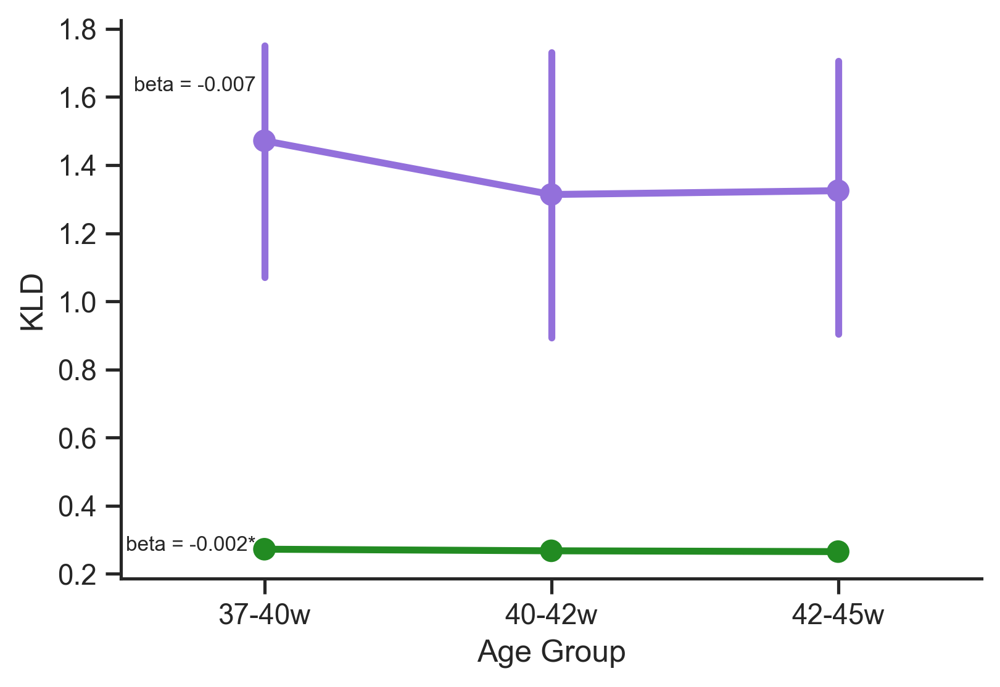

In [253]:
sns.set_style("ticks")
plt.rcParams['figure.dpi'] = 300
fig, ax = plt.subplots(figsize=(6,4))

# dense version
mad = df.groupby('Age Group')['KLD'].mad(skipna=True)
sns.pointplot(data=df, x="Age Group", y="KLD", cf=mad,
                   estimator=np.median, color="forestgreen", linestyle='', 
              ax=ax, label="Dense\n")
# , cf="sd"
# and the best fit
mask = ~np.isnan(df['KLD'].values)
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df['Age Group Average'].values[mask], 
                                                                     df['KLD'].values[mask])
if p_value < 0.01/2:
    label_line = f'beta = {slope:.3f}*\n'
else:
    label_line = f'beta = {slope:.3f}\n'

ax.text(-0.03, 0.25, label_line, va='center', ha='right', fontsize=8)

# parcellated version
mad = df_parc.groupby('Age Group')['KLD'].mad(skipna=True)
sns.pointplot(data=df_parc, x="Age Group", y="KLD", cf=mad,
                   estimator=np.median, color="mediumpurple", linestyle='', 
              ax=ax, label="Parcellated\n")

# and the best fit equation
mask = ~np.isnan(df_parc['KLD'].values)
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df_parc['Age Group Average'].values[mask], 
                                                                     df_parc['KLD'].values[mask])
if p_value < 0.01/2:
    label_line = f'beta = {slope:.3f}*\n'
else:
    label_line = f'beta = {slope:.3f}\n'

ax.text(-0.03, 1.6, label_line, va='center', ha='right', fontsize=8)
sns.despine()

In [254]:
df_parc.groupby('Age Group')['KLD'].describe()

,count,mean,std,min,25%,50%,75%,max
Age Group,,,,,,,,
37-40w,33.0,1.600227,0.983908,0.398939,0.870272,1.471455,1.989918,4.530824
40-42w,33.0,1.567978,0.992046,0.363412,0.861670,1.313664,1.950606,4.625356
42-45w,33.0,1.566823,1.017430,0.394657,0.880714,1.324851,1.869519,4.775617


In [255]:
# # legend
# sns.set_style("ticks")
# import matplotlib.patches as mpatches
# mean_patch = mpatches.Patch(color='forestgreen', label='Dense')    
# median_patch = mpatches.Patch(color='mediumpurple', label='Parcellated')    
# plt.legend(handles=[mean_patch, median_patch], fontsize=18)


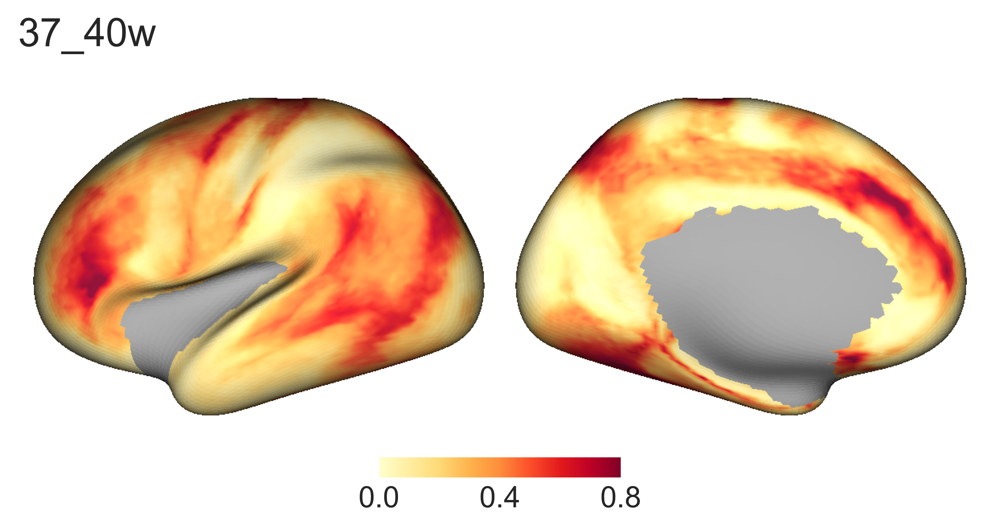

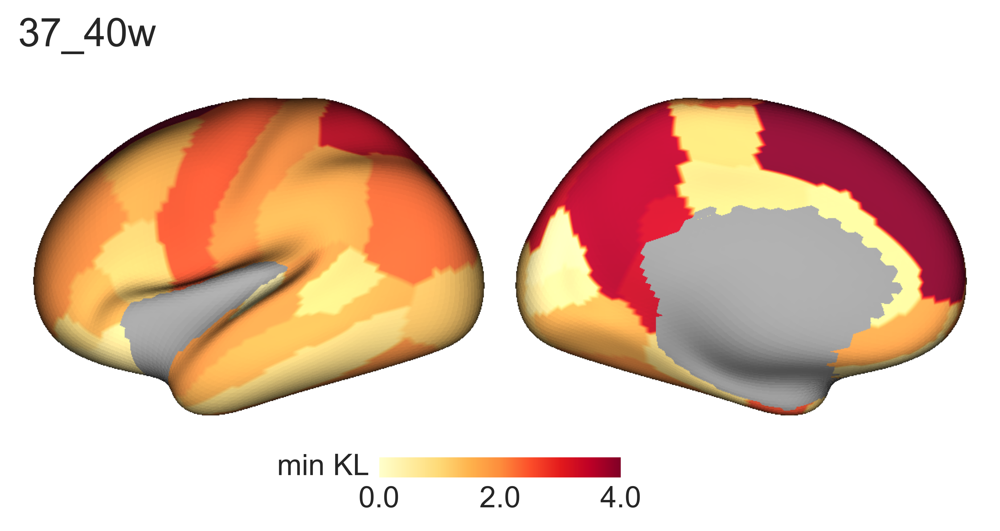

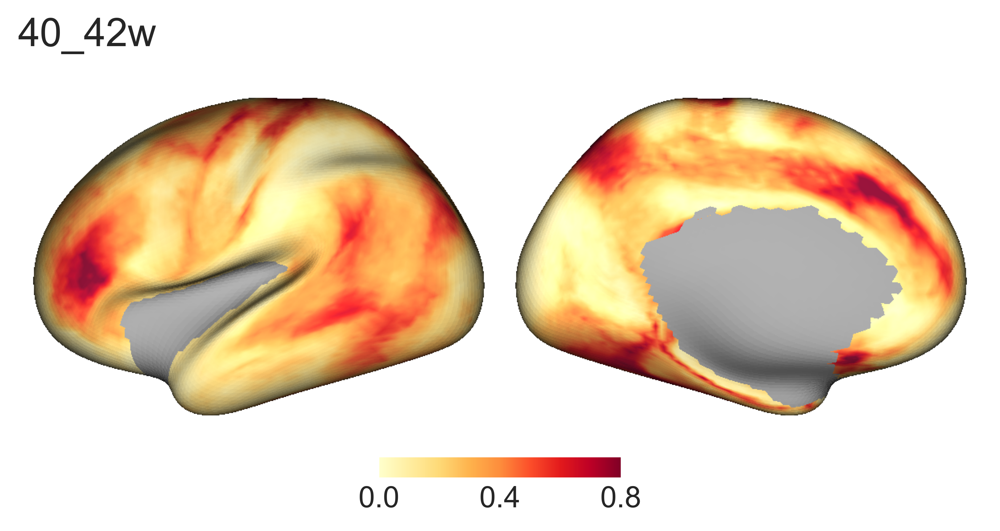

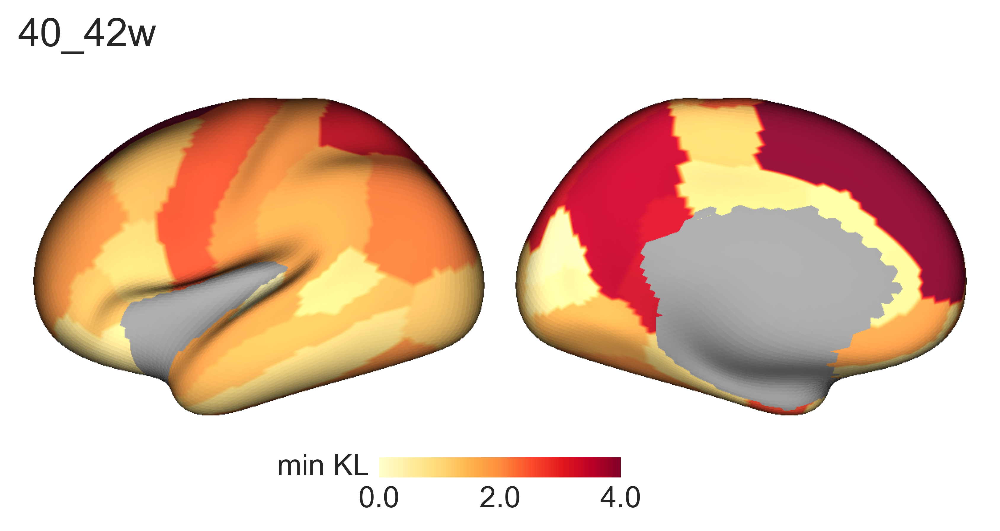

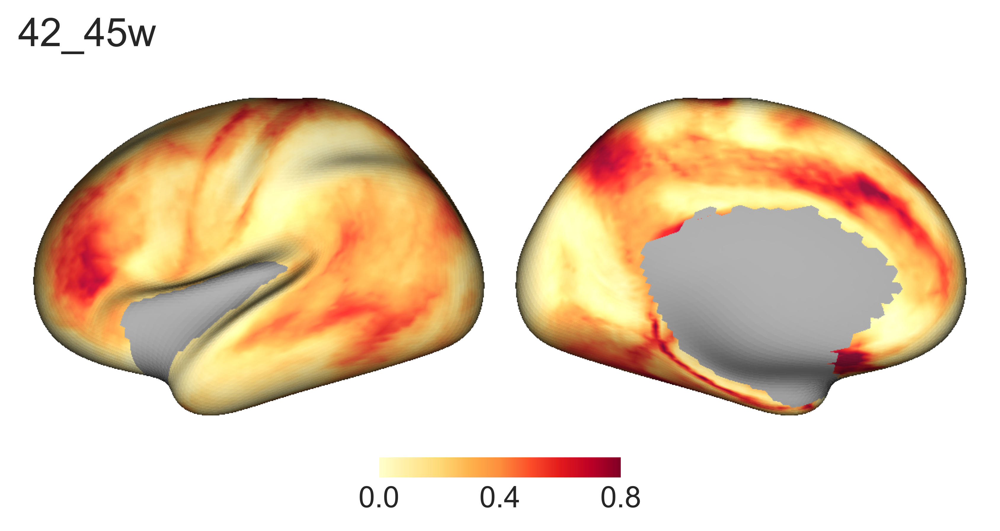

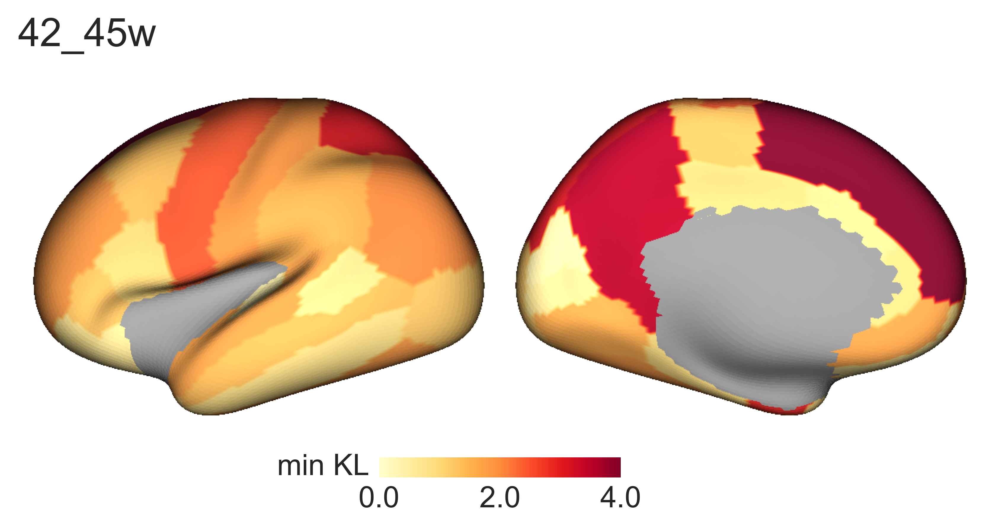

In [256]:
# plot surface maps - dense and parcellated
for group in age_groups:
    # dense
    g_path = f"{results_dir}/hum_{group}_minKLD.dscalar.nii"
    plot_surf(g_path, 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'YlOrRd', [0, 0.8], group, cbar_title="")
    
    # parcellated
    g_path = f"{results_dir}/hum_{group}_KLD_parc.dscalar.nii"
    plot_surf(g_path, 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'YlOrRd', [0, 4], group, cbar_title="min KL")
        
 

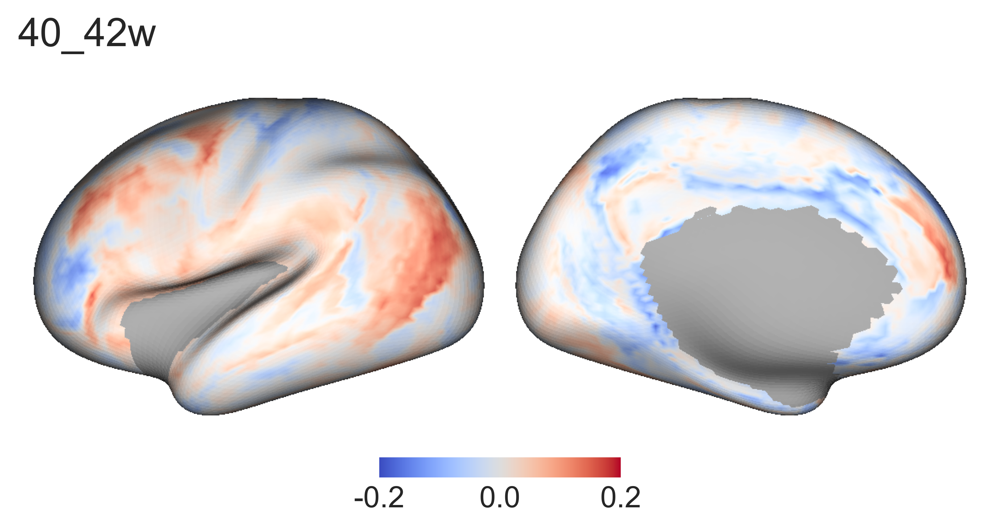

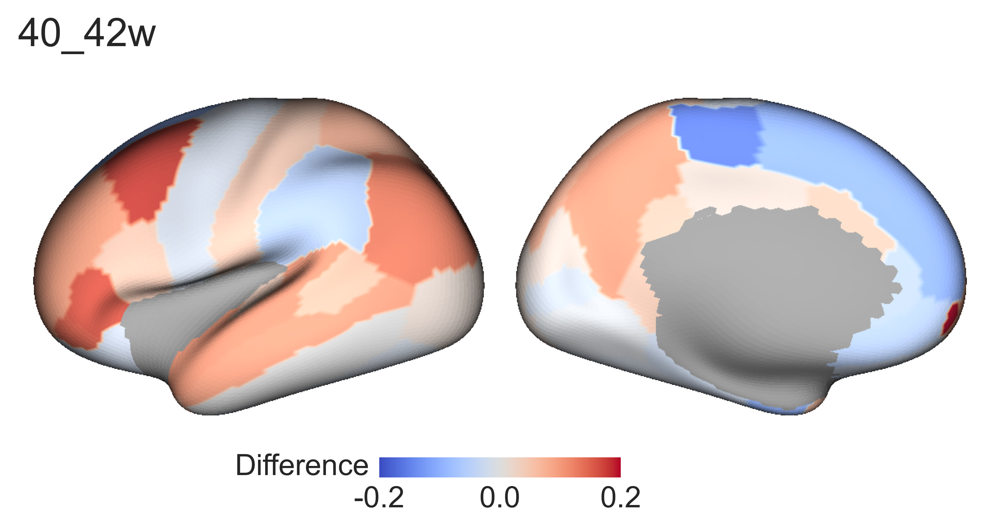

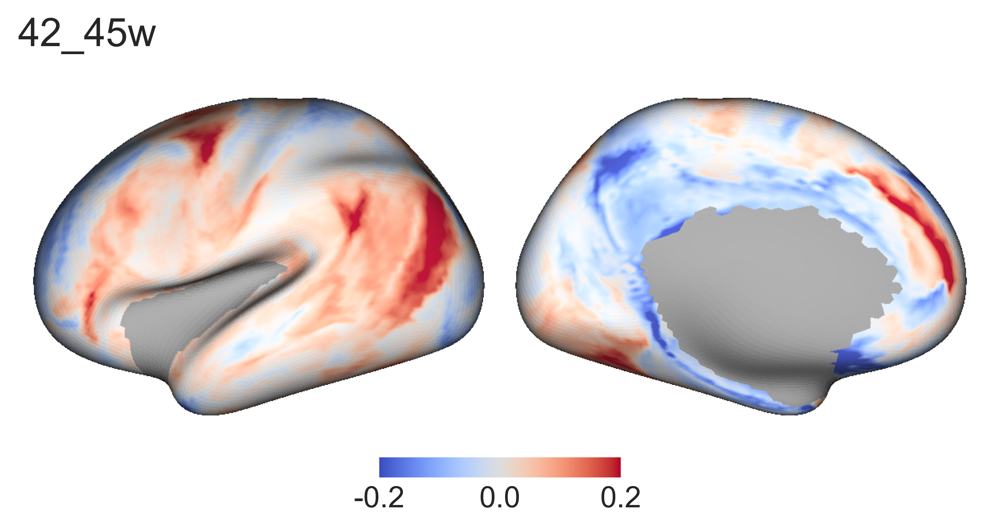

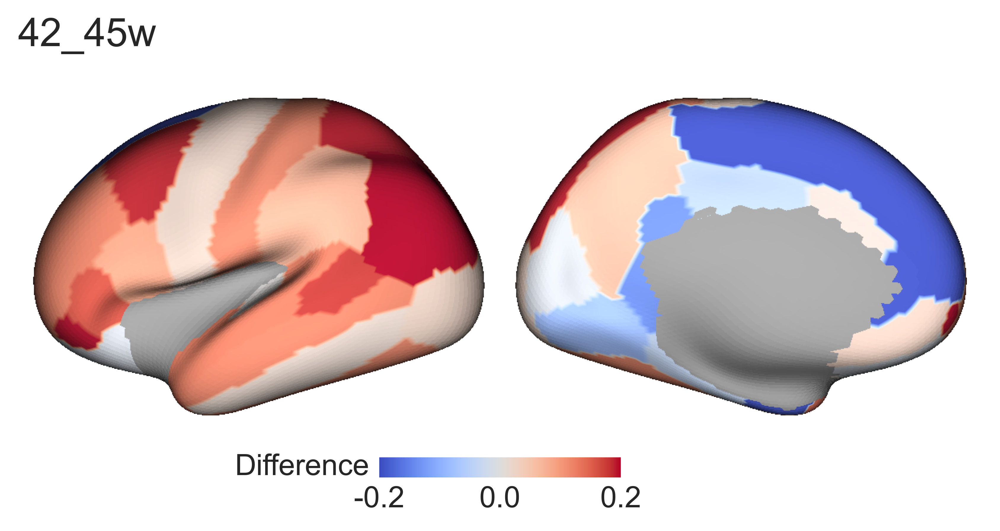

In [258]:
# plot difference (relative to 37-40w) surface maps - dense and parcellated
g1 = nib.load(f"{results_dir}/hum_{age_groups[0]}_minKLD.dscalar.nii")
g1 = np.asanyarray(g1.dataobj)

g1_parc = nib.load(f"{results_dir}/hum_{age_groups[0]}_KLD_parc.dscalar.nii")
g1_parc = np.asanyarray(g1_parc.dataobj)

for group in age_groups[1:]:
    # dense
    g2 = nib.load(f"{results_dir}/hum_{group}_minKLD.dscalar.nii")
    g2 = np.asanyarray(g2.dataobj)
    g2 = g1-g2
    data_to_cifti(g2, f"{results_dir}/{group}_{age_groups[0]}_diff.dscalar.nii", hum_roi_l, hum_roi_r)
    plot_surf(f"{results_dir}/{group}_{age_groups[0]}_diff.dscalar.nii", 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'coolwarm', [-0.2, 0.2], group, cbar_title="")
    
    # parcellated
    g2 = nib.load(f"{results_dir}/hum_{group}_KLD_parc.dscalar.nii")
    g2 = np.asanyarray(g2.dataobj)
    g2 = g1_parc-g2
    
    data_to_cifti(g2, f"{results_dir}/{group}_{age_groups[0]}_diff_parc.dscalar.nii", hum_roi_l, hum_roi_r)
    
    plot_surf(f"{results_dir}/{group}_{age_groups[0]}_diff_parc.dscalar.nii", 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'coolwarm', [-0.2, 0.2], group, cbar_title="Difference")
        
 

[Text(0.5, 17.688888888888872, 'Age Group')]

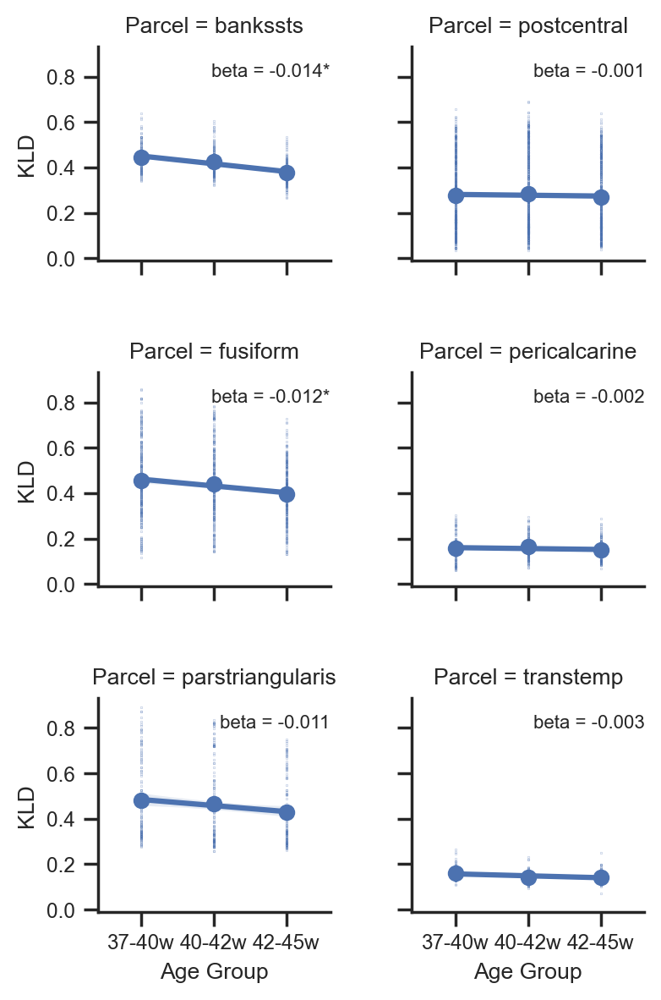

In [259]:
# and for a subset of parcels
plt.rcParams['figure.dpi'] = 200
sns.set(font_scale=0.8)
sns.set_style("ticks")
# sns.set_theme()

parcs = ['bankssts', 'postcentral', 
         'fusiform', 'pericalcarine',
        'parstriangularis', 'transtemp']


g = sns.lmplot(data=df.loc[df.Parcel.isin(parcs)], x='Age Group Average', y='KLD', col='Parcel', col_order=parcs,
               height=2, aspect=1, col_wrap=2, sharey=True, scatter_kws={"s": 0.01})

for ax in g.axes:
    # dense
    p = ax.title.get_text().split("= ",1)[1] 
    temp_df = df.loc[df.Parcel.isin([p])]
    mask = ~np.isnan(temp_df['KLD'].values)
    slope, bar, foo, p_value, foobar = scipy.stats.linregress(temp_df['Age Group Average'].values[mask], 
                                                                         temp_df['KLD'].values[mask])
    
    ax.plot(temp_df.groupby("Age Group Average").describe().KLD['mean'], linestyle = 'None', marker='o')
    
    if p_value < 0.01/np.unique(df.Parcel.values).shape[0]:
        label_line = f'beta = {slope:.3f}*'
    else:
        label_line = f'beta = {slope:.3f}'
    ax.text(45, 0.8, label_line, ha='right', fontsize=8)

g.set(xticks=age_group_averages, xticklabels=df["Age Group"].unique(), xlim=[37,45])
g.fig.tight_layout(w_pad=3, h_pad=3)
g.axes[4].set(xlabel='Age Group')
g.axes[5].set(xlabel='Age Group')

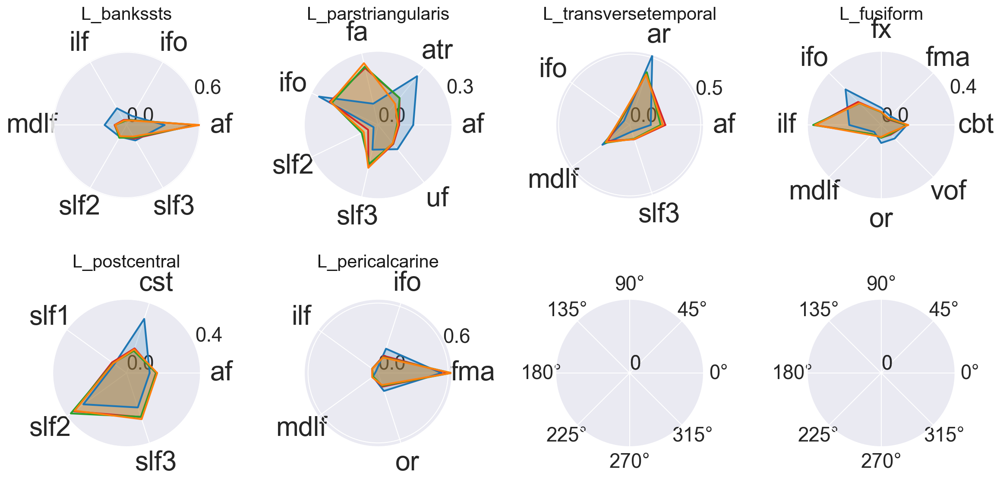

In [262]:
# look at connectivity to given regions
thr = 0.05 # threshold on tract contribution to get top contributors per parcel
tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))

# parcels to include

labels = ["L_bankssts", "L_parstriangularis", "L_transversetemporal", 
         "L_fusiform", "L_postcentral", "L_pericalcarine"]

n_labs = len(labels)

temp_dict = fs_label_dict.copy()
temp_dict.reset_index(inplace=True)

plt.rcParams['figure.dpi'] = 150
sns.set_theme()
sns.set(font_scale=2)

k = 4 # how many columns
m = int(np.ceil(len(labels)/k)) # how many rows
fig, ax = plt.subplots(m, k, subplot_kw=dict(projection='polar'), figsize=(k*4, m*4))

# Load age group data
group_bp1 = load_age_bp(age_groups[0])
group_bp2 = load_age_bp(age_groups[1])
group_bp3 = load_age_bp(age_groups[2])

n = 0
for j in range(m):
    for i in range(k):
        if n < n_labs:
            ii = temp_dict.index[temp_dict['NAME'] == labels[n]][0]
            
            # get parcel connectivity profiles
            hum = get_parc_profile(hum_parc, hum_bp_hemi, labels[n])
            group1 = get_parc_profile(neo_parc, group_bp1, labels[n])
            group2 = get_parc_profile(neo_parc, group_bp2, labels[n])
            group3 = get_parc_profile(neo_parc, group_bp3, labels[n])
            
            # get index of tracts to include (top tracts from each brain)
            ind = np.argwhere(group1[:]>thr)
            grot_ind = np.argwhere(group2[:]>thr)
            ind = np.unique(np.append(ind, grot_ind))
            grot_ind = np.argwhere(group3[:]>thr)
            ind = np.unique(np.append(ind, grot_ind))            
            grot_ind = np.argwhere(hum[:]>thr)
            ind = np.unique(np.append(ind, grot_ind))
            
            grot_lab = [tract_names[s] for s in ind]
            theta = np.linspace(0, 2 * np.pi, len(grot_lab), endpoint=False)
            
            # and plot
            def plot_radar(data, theta, label, color):
                pline = [*data, data[0]]
                thetaline = [*theta, theta[0]]
                ax[j,i].plot(thetaline, pline, linewidth=2, color=color, label=label)
                ax[j,i].fill(thetaline, pline, color, alpha=0.2, label=label)               
            
            hum = hum[ind]/np.sum(hum[ind])
            group3 = group3[ind]/np.sum(group3[ind])
            group2 = group2[ind]/np.sum(group2[ind])
            group1 = group1[ind]/np.sum(group1[ind])
            
            vmax = np.max((np.max(hum), 
               np.max(group1), 
               np.max(group2), 
               np.max(group3)
              ))*1.01
            
            # adult
            plot_radar(hum, theta, "adult", "tab:blue")
            # group3
            plot_radar(group3, theta, age_groups[2], "tab:red")  
            # group2
            plot_radar(group2, theta, age_groups[1], "tab:green")   
            # group1
            plot_radar(group1, theta, age_groups[0], "tab:orange")  
            
            ax[j,i].set_title(f'{labels[n]}', size=20, y=1.18, color='k')
            ax[j,i].set_rlim(bottom=0, top=vmax)
            ax[j,i].set_rticks([0, np.round(vmax,1)])
            ax[j,i].set_xticks(theta)
            ax[j,i].set_xticklabels(grot_lab, fontdict={'fontsize':30})
            ax[j,i].tick_params(axis='x', which='major', pad=10)

        if n >= n_labs:
            ax[j,i].set_rticks([0, 0])
        n += 1
        
fig.tight_layout()
fig.savefig('/Users/shaunwarrington/Downloads/radar_plots.png', transparent=False)


In [263]:
# # legend for paper figure
# sns.set_style("ticks")
# import matplotlib.patches as mpatches
# ad_patch = mpatches.Patch(color='tab:blue', label='Adult (reference)')    
# g1_patch = mpatches.Patch(color='tab:orange', label='37-40w')
# g2_patch = mpatches.Patch(color='tab:green', label='40-42w')  
# g3_patch = mpatches.Patch(color='tab:red', label='42-45w')
# plt.legend(handles=[ad_patch, g1_patch, g2_patch, g3_patch], fontsize=18)


## connectivity profiles for figure 4 schematic

In [64]:
# temp = np.zeros((hum_bp_hemi.shape[0], hum_mask.shape[0]))
# temp[:, hum_mask == 1] = hum_bp_hemi
# tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))

# plt.plot(tract_names, temp[:,4862])
# foo = plt.xticks(rotation=90) 

In [65]:
# temp = np.zeros((neo_bp_hemi.shape[0], neo_mask.shape[0]))
# temp[:, neo_mask == 1] = neo_bp_hemi
# plt.plot(tract_names, temp[:,4862])
# foo = plt.xticks(rotation=90) 

In [66]:
# temp = np.zeros((mac_bp_hemi.shape[0], mac_mask.shape[0]))
# temp[:, mac_mask == 1] = mac_bp_hemi
# plt.plot(tract_names, temp[:,4700])
# foo = plt.xticks(rotation=90) 

In [67]:
# # connectivity profiles for figure 4
# # look at connectivity to given regions
# thr = 0.05 # threshold on tract contribution to get top contributors per parcel
# tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))

# # adult vertices
# # temp = np.zeros((hum_bp_hemi.shape[0], hum_mask.shape[0]))
# # temp[:, hum_mask == 1] = hum_bp_hemi
# # labels = [4862, 9578, 5382]

# # # neonate vertices
# # temp = np.zeros((neo_bp_hemi.shape[0], neo_mask.shape[0]))
# # temp[:, neo_mask == 1] = neo_bp_hemi
# # labels = [5385, 
# #           4862, 9578, 5382]

# # macaque vertices
# temp = np.zeros((mac_bp_hemi.shape[0], mac_mask.shape[0]))
# temp[:, mac_mask == 1] = mac_bp_hemi
# labels = [4700, 
#           4700, 4700, 4700]

# n_labs = len(labels)
# plt.rcParams['figure.dpi'] = 300
# sns.set_theme()
# sns.set(font_scale=2)

# k = 2 # how many columns
# m = int(np.ceil(len(labels)/k)) # how many rows
# fig, ax = plt.subplots(m, k, subplot_kw=dict(projection='polar'), figsize=(k*4, m*4))

# # Load age group data
# # group_bp1 = load_age_bp(age_groups[0])

# n = 0
# for j in range(m):
#     for i in range(k):
#         if n < n_labs:
#             # get parcel connectivity profiles
#             dat = temp[:, labels[n]]       
#             ind = np.argwhere(dat[:]>thr)
#             ind = np.unique(ind)
#             grot_lab = [tract_names[s] for s in ind]
            
#             theta = np.linspace(0, 2 * np.pi, len(grot_lab), endpoint=False)
#             vmax = np.max(dat[ind])*1.01
            
#             # and plot
#             def plot_radar(data, ind, theta, label, color):
#                 pline = [*data[ind], data[ind[0]]]
#                 thetaline = [*theta, theta[0]]
#                 ax[j,i].plot(thetaline, pline, linewidth=2, color=color, label=label)
#                 ax[j,i].fill(thetaline, pline, color, alpha=0.2, label=label)                
            
#             # adult
#             plot_radar(dat, ind, theta, "macaque", "tab:orange")                  
                       
#             ax[j,i].set_title(f'{np.str(labels[n])}', size=10, y=1.18)
#             ax[j,i].set_rlim(bottom=0, top=vmax)
#             ax[j,i].set_rticks([])
#             ax[j,i].set_xticks(theta)
#             ax[j,i].set_xticklabels(grot_lab, fontdict={'fontsize':20})
#             ax[j,i].tick_params(axis='x', which='major', pad=10)

#         if n >= n_labs:
#             ax[j,i].set_rticks([0, 0])
#         n += 1
        
# fig.tight_layout()


## supplementary figures

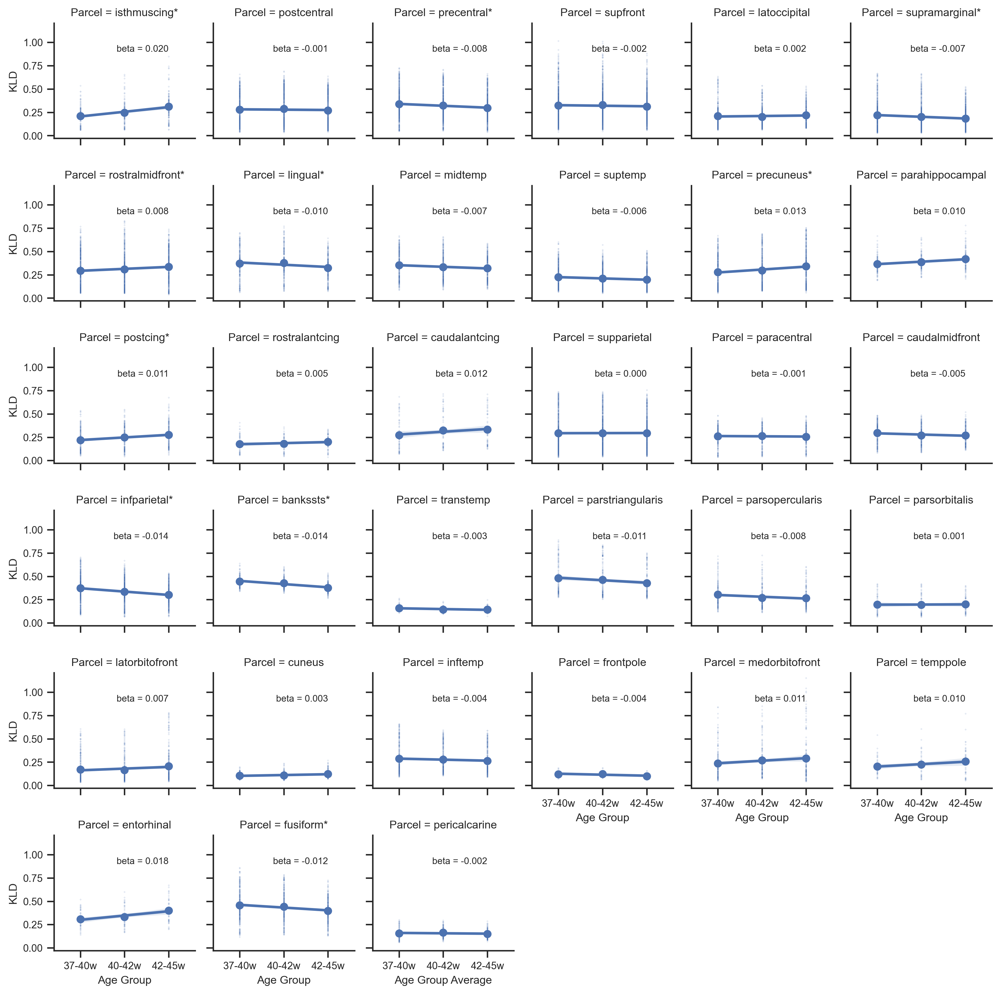

In [624]:
# plot dense parcel-wise minn KL vs age for all parcels for supplementary
plt.rcParams['figure.dpi'] = 300
sns.set(font_scale=0.8)
sns.set_style("ticks")

g = sns.lmplot(data=df, x='Age Group Average', y='KLD', col='Parcel',
               height=2, aspect=1, col_wrap=6, sharey=True, scatter_kws={"s": 0.01})

p_keep = []
for ax in g.axes:
    p = ax.title.get_text().split("= ",1)[1] 
    temp_df = df.loc[df.Parcel.isin([p])]
    mask = ~np.isnan(temp_df['KLD'].values)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(temp_df['Age Group Average'].values[mask], 
                                                                         temp_df['KLD'].values[mask])
    
    ax.plot(temp_df.groupby("Age Group Average").describe().KLD['mean'], linestyle = 'None', marker='o')
    
    label_line = f'beta = {slope:.3f}'
    ax.text(43.5, 0.9, label_line, ha='right', fontsize=8)
    
    if p_value < 0.01/np.unique(df.Parcel.values).shape[0]:
        ax.set_title(f'{ax.title.get_text()}*')

        
g.set(xticks=age_group_averages, xticklabels=df["Age Group"].unique(), xlim=[37,45])
g.fig.tight_layout(w_pad=3, h_pad=3)

for i in range(27,32):
    g.axes[i].set(xlabel='Age Group')

g.fig.tight_layout(w_pad=1)

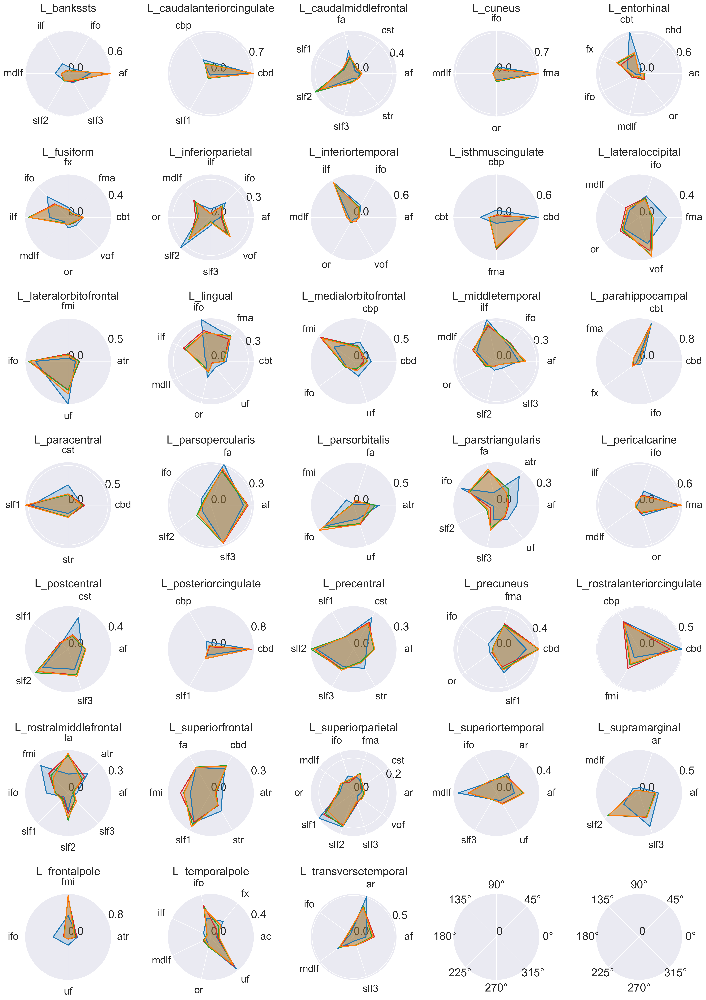

In [49]:
# # connectivity to all regions for supplementary
# thr = 0.05 # threshold on tract contribution to get top contributors per parcel
# tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))

# # parcels to include
# labels = fs_label_dict.NAME.values

# n_labs = len(labels)

# temp_dict = fs_label_dict.copy()
# temp_dict.reset_index(inplace=True)

# plt.rcParams['figure.dpi'] = 300
# sns.set_theme()
# sns.set(font_scale=2)

# k = 5 # how many columns
# m = int(np.ceil(len(labels)/k)) # how many rows
# fig, ax = plt.subplots(m, k, subplot_kw=dict(projection='polar'), figsize=(k*4, m*4))

# # Load age group data
# group_bp1 = load_age_bp(age_groups[0])
# group_bp2 = load_age_bp(age_groups[1])
# group_bp3 = load_age_bp(age_groups[2])

# n = 0
# for j in range(m):
#     for i in range(k):
#         if n < n_labs:
#             ii = temp_dict.index[temp_dict['NAME'] == labels[n]][0]
            
#             # get parcel connectivity profiles
#             hum = get_parc_profile(hum_parc, hum_bp_hemi, labels[n])
#             group1 = get_parc_profile(neo_parc, group_bp1, labels[n])
#             group2 = get_parc_profile(neo_parc, group_bp2, labels[n])
#             group3 = get_parc_profile(neo_parc, group_bp3, labels[n])
            
#             # get index of tracts to include (top tracts from each brain)
#             ind = np.argwhere(group1[:]>thr)
#             grot_ind = np.argwhere(group2[:]>thr)
#             ind = np.unique(np.append(ind, grot_ind))
#             grot_ind = np.argwhere(group3[:]>thr)
#             ind = np.unique(np.append(ind, grot_ind))            
#             grot_ind = np.argwhere(hum[:]>thr)
#             ind = np.unique(np.append(ind, grot_ind))
            
#             grot_lab = [tract_names[s] for s in ind]
            
#             theta = np.linspace(0, 2 * np.pi, len(grot_lab), endpoint=False)

#             vmax = np.max((np.max(hum[ind]), 
#                            np.max(group1[ind]), 
#                            np.max(group2[ind]), 
#                            np.max(group3[ind])
#                           ))*1.01
            
#             # and plot
#             def plot_radar(data, theta, label, color):
#                 pline = [*data, data[0]]
#                 thetaline = [*theta, theta[0]]
#                 ax[j,i].plot(thetaline, pline, linewidth=2, color=color, label=label)
#                 ax[j,i].fill(thetaline, pline, color, alpha=0.2, label=label)                          
            
#             hum = hum[ind]/np.sum(hum[ind])
#             group3 = group3[ind]/np.sum(group3[ind])
#             group2 = group2[ind]/np.sum(group2[ind])
#             group1 = group1[ind]/np.sum(group1[ind])
            
#             vmax = np.max((np.max(hum), 
#                np.max(group1), 
#                np.max(group2), 
#                np.max(group3)
#               ))*1.01
            
#             # adult
#             plot_radar(hum, theta, "adult", "tab:blue")
#             # group3
#             plot_radar(group3, theta, age_groups[2], "tab:red")  
#             # group2
#             plot_radar(group2, theta, age_groups[1], "tab:green")   
#             # group1
#             plot_radar(group1, theta, age_groups[0], "tab:orange")                     
                       
#             ax[j,i].set_title(f'{labels[n]}', size=22, y=1.18)
#             ax[j,i].set_rlim(bottom=0, top=vmax)
#             ax[j,i].set_rticks([0, np.round(vmax,1)])
#             ax[j,i].set_xticks(theta)
#             ax[j,i].set_xticklabels(grot_lab, fontdict={'fontsize':20})
#             ax[j,i].tick_params(axis='x', which='major', pad=10)
            
#         if n >= n_labs:
#             ax[j,i].set_rticks([0, 0])
#         n += 1
        
# fig.tight_layout()


## KL diverence across ontogeny and phylogeny
### Calculate KL between:
### neonate and macaque
### neonate and adult
### macaque and adult

In [23]:
#hum to neo
D_l = KLD(neo_bp_hemi[:,:neo_n_left].T, hum_bp_hemi[:,:hum_n_left].T)
D_r = KLD(neo_bp_hemi[:,neo_n_left:].T, hum_bp_hemi[:,hum_n_left:].T)

D_l[D_l == 0] = np.nan
D_r[D_r == 0] = np.nan

neo_min_KLD = np.concatenate((np.nanmin(D_l, axis=1), np.nanmin(D_r, axis=1)))
humneo_min_KLD = np.concatenate((np.nanmin(D_l, axis=0), np.nanmin(D_r, axis=0)))
data_to_cifti(neo_min_KLD, "{}/neohum_min_KLD.dscalar.nii".format(results_dir), neo_roi_l, neo_roi_r)
data_to_cifti(humneo_min_KLD, "{}/humneo_min_KLD.dscalar.nii".format(results_dir), hum_roi_l, hum_roi_r)
humneo_KL = np.copy(D_l)

#mac to neo
D_l = KLD(neo_bp_hemi[:,:neo_n_left].T, mac_bp_hemi[:,:mac_n_left].T)
D_r = KLD(neo_bp_hemi[:,neo_n_left:].T, mac_bp_hemi[:,mac_n_left:].T)

D_l[D_l == 0] = np.nan
D_r[D_r == 0] = np.nan

neo_min_KLD = np.concatenate((np.nanmin(D_l, axis=1), np.nanmin(D_r, axis=1)))
macneo_min_KLD = np.concatenate((np.nanmin(D_l, axis=0), np.nanmin(D_r, axis=0)))
data_to_cifti(neo_min_KLD, "{}/neomac_min_KLD.dscalar.nii".format(results_dir), neo_roi_l, neo_roi_r)
data_to_cifti(macneo_min_KLD, "{}/macneo_min_KLD.dscalar.nii".format(results_dir), mac_roi_l, mac_roi_r)
macneo_KL = np.copy(D_l)

#hum to mac
D_l = KLD(mac_bp_hemi[:,:mac_n_left].T, hum_bp_hemi[:,:hum_n_left].T)
D_r = KLD(mac_bp_hemi[:,mac_n_left:].T, hum_bp_hemi[:,hum_n_left:].T)

D_l[D_l == 0] = np.nan
D_r[D_r == 0] = np.nan

mac_min_KLD = np.concatenate((np.nanmin(D_l, axis=1), np.nanmin(D_r, axis=1)))
hummac_min_KLD = np.concatenate((np.nanmin(D_l, axis=0), np.nanmin(D_r, axis=0)))
data_to_cifti(mac_min_KLD, "{}/machum_min_KLD.dscalar.nii".format(results_dir), mac_roi_l, mac_roi_r)
data_to_cifti(hummac_min_KLD, "{}/hummac_min_KLD.dscalar.nii".format(results_dir), hum_roi_l, hum_roi_r)
hummac_KL = np.copy(D_l)


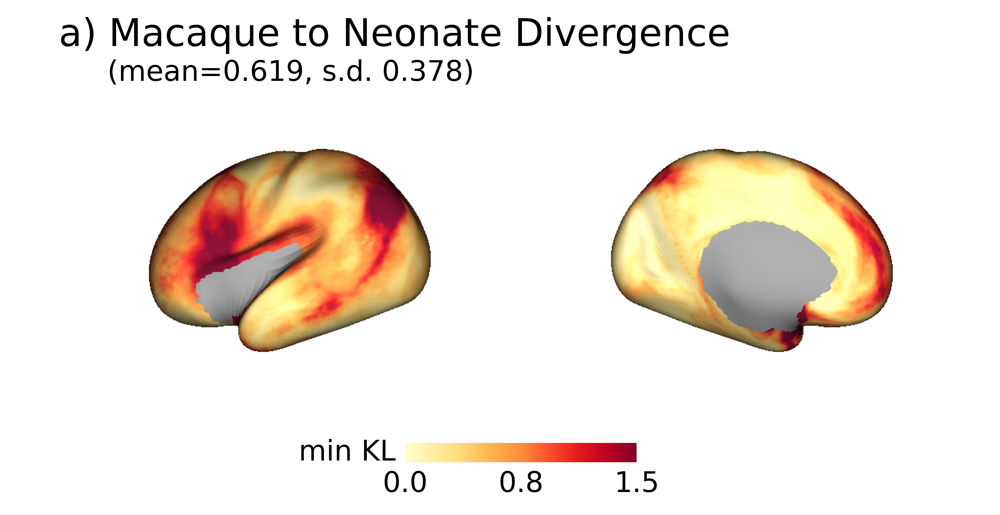

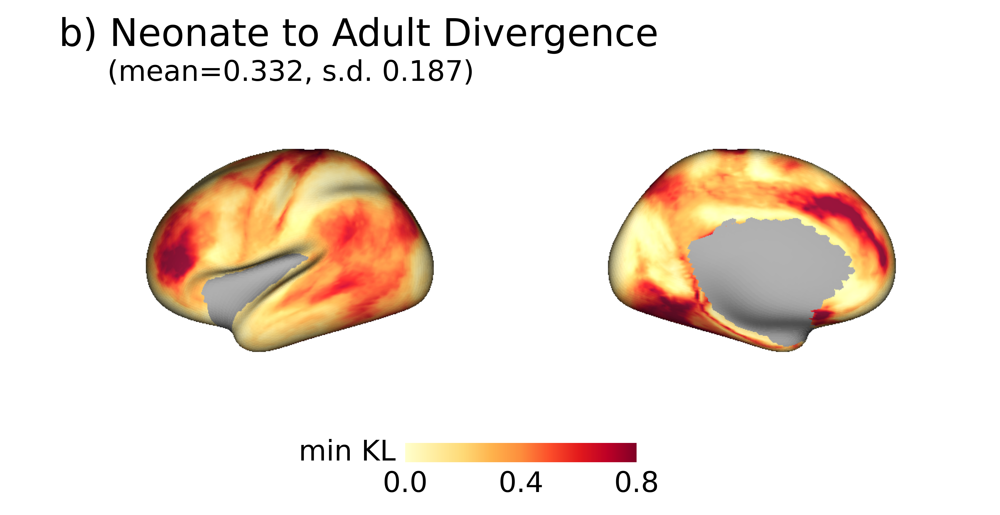

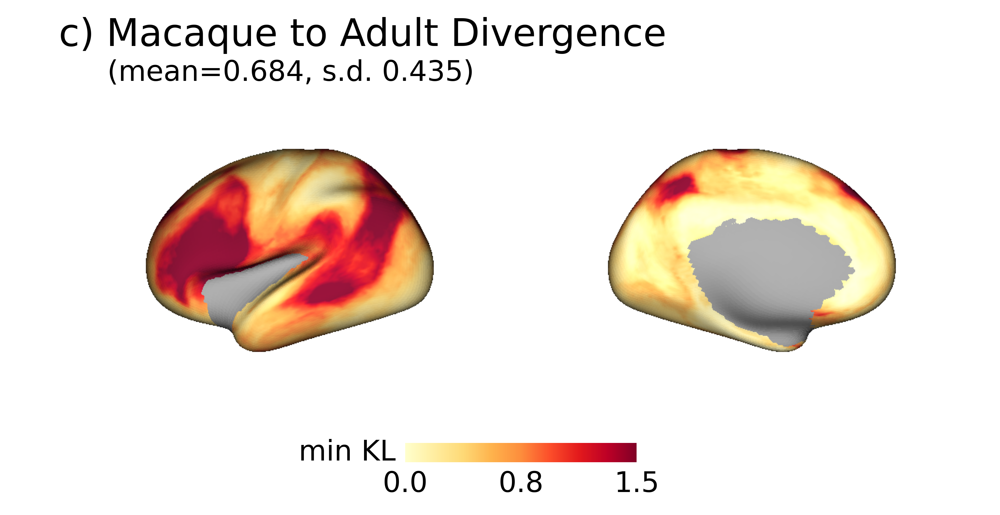

In [29]:
# plot min KL maps
# mac to neonate
mn = f'{np.nanmean(neo_min_KLD[:neo_n_left]):.3f}'
sd = f'{np.nanstd(neo_min_KLD[:neo_n_left]):.3f}'
plot_surf(f'{results_dir}/neomac_min_KLD.dscalar.nii', 
           f'{surf_dir}/L.rneo.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rneo.very_inflated.resampled.surf.gii',
           neo_roi_l, neo_roi_r, 'YlOrRd', [0, 1.5], 'a) Macaque to Neonate Divergence', 
           cbar_title="min KL", zoom=1.2, mean=mn, sd=sd)
    
# neonate to adult
mn = f'{np.nanmean(humneo_min_KLD[:hum_n_left]):.3f}'
sd = f'{np.nanstd(humneo_min_KLD[:hum_n_left]):.3f}'
plot_surf(f'{results_dir}/humneo_min_KLD.dscalar.nii', 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'YlOrRd', [0, 0.8], 'b) Neonate to Adult Divergence', 
           cbar_title="min KL", zoom=1.2, mean=mn, sd=sd)
    
# mac to adult
mn = f'{np.nanmean(hummac_min_KLD[:hum_n_left]):.3f}'
sd = f'{np.nanstd(hummac_min_KLD[:hum_n_left]):.3f}'

plot_surf(f'{results_dir}/hummac_min_KLD.dscalar.nii', 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'YlOrRd', [0, 1.5], 'c) Macaque to Adult Divergence', 
           cbar_title="min KL", zoom=1.2, mean=mn, sd=sd)


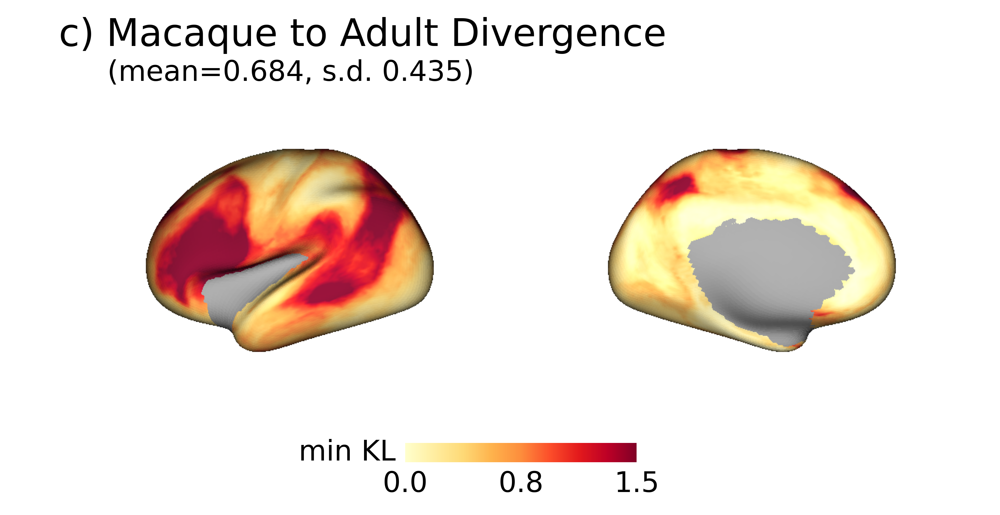

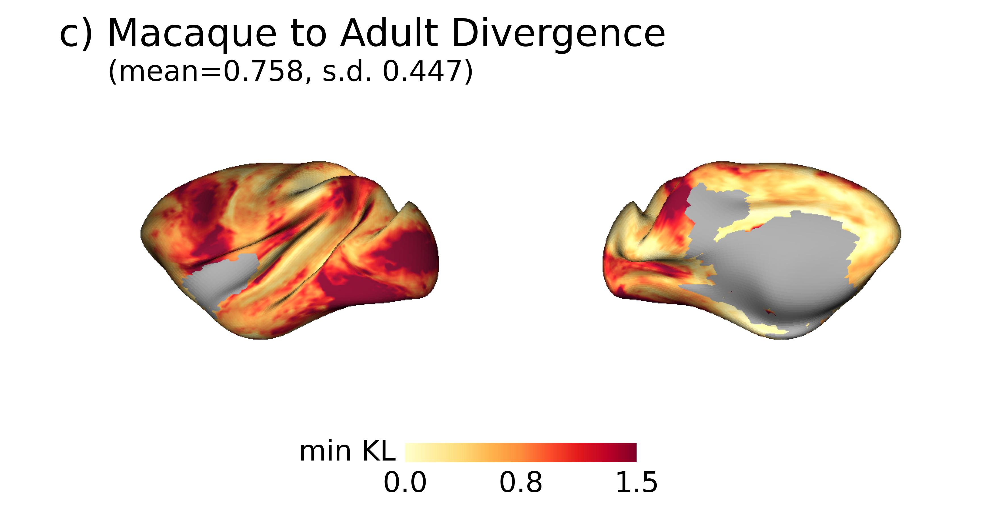

In [25]:
mn = f'{np.nanmean(hummac_min_KLD[:hum_n_left]):.3f}'
sd = f'{np.nanstd(hummac_min_KLD[:hum_n_left]):.3f}'
plot_surf(f'{results_dir}/hummac_min_KLD.dscalar.nii', 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'YlOrRd', [0, 1.5], 'c) Macaque to Adult Divergence', 
           cbar_title="min KL", zoom=1.2, mean=mn, sd=sd)


mn = f'{np.nanmean(mac_min_KLD[:mac_n_left]):.3f}'
sd = f'{np.nanstd(mac_min_KLD[:mac_n_left]):.3f}'
plot_surf(f'{results_dir}/machum_min_KLD.dscalar.nii', 
           f'{surf_dir}/L.rmac.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rmac.very_inflated.resampled.surf.gii',
           mac_roi_l, mac_roi_r, 'YlOrRd', [0, 1.5], 'c) Macaque to Adult Divergence', 
           cbar_title="min KL", zoom=1.2, mean=mn, sd=sd)

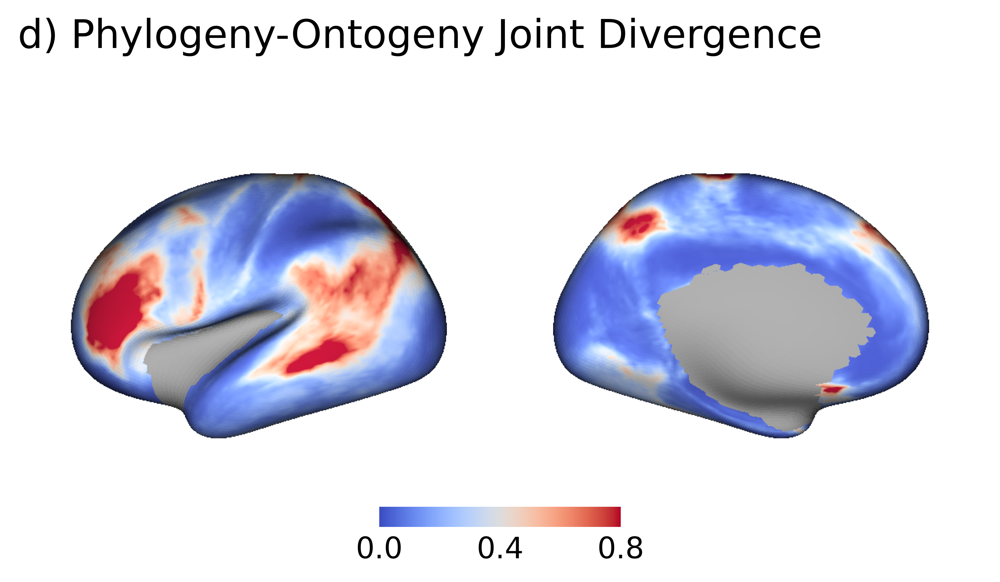

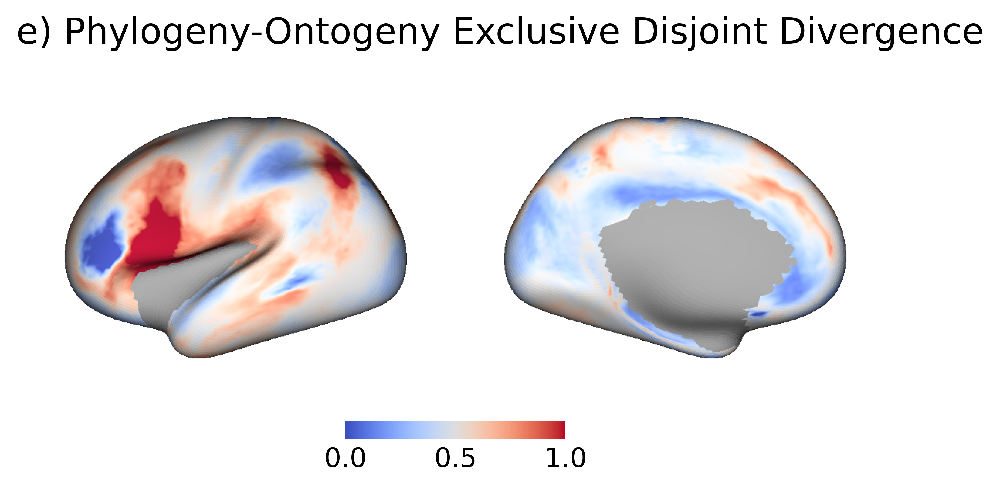

In [23]:
# joint-dissimilairty and exclusive disjoint
# hum-neo
humneo = nib.load(f"{results_dir}/humneo_min_KLD.dscalar.nii")
humneo = np.asanyarray(humneo.dataobj)

# hum-mac
hummac = nib.load(f"{results_dir}/hummac_min_KLD.dscalar.nii")
hummac = np.asanyarray(hummac.dataobj)

# product (the joint-dissimilarity)
jdiss = np.multiply(humneo, hummac)
data_to_cifti(jdiss, f"{results_dir}/hum_jdiss.dscalar.nii", hum_roi_l, hum_roi_r)

plot_surf(f'{results_dir}/hum_jdiss.dscalar.nii', 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'coolwarm', [0, 0.8], 
          'd) Phylogeny-Ontogeny Joint Divergence\n', cbar_title="", zoom=1.5)

# XOR (exclusive disjoint set=Union-Intersection) approximated as A+B-2AB
# where A = Macaque2Adult, B = Neonate2Adult
xor = (hummac+humneo) - (2*hummac*humneo)
data_to_cifti(xor, f"{results_dir}/hum_xor.dscalar.nii", hum_roi_l, hum_roi_r)

plot_surf(f'{results_dir}/hum_xor.dscalar.nii', 
           f'{surf_dir}/L.rhum.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rhum.very_inflated.resampled.surf.gii',
           hum_roi_l, hum_roi_r, 'coolwarm', [0, 1], 
          'e) Phylogeny-Ontogeny Exclusive Disjoint Divergence', cbar_title="", zoom=1.5)


In [26]:
# function to get fingerprints (actually indicies) in other (neonate or macaque) brain based on adult vertex
def get_fingerprint_from_vert(vert_ind, mask1, mask2, KLmat):
    # create zeros copy of mask and set the vertex of interest to 1
    findv = np.zeros_like(mask1)
    findv[vert_ind] = 1
    
    # remove medial wall and re-find the 1 entry
    findv = findv[mask1==1]
    bp1_ind = np.argwhere(findv == 1)[0] # the KL index for the adult vector
    print(bp1_ind)
    # extract the KL vector and find the min KL vertex in the other brain
    KL_vec = KLmat[:, bp1_ind]
    bp2_ind = np.argwhere(KL_vec == np.nanmin(KL_vec))[0][0] # the index of the min KL vertex in other brain
    print(bp2_ind)
    # convert index to surface with medial wall for figure indicator
    show_ind = np.zeros_like(KL_vec)
    show_ind = show_ind.reshape(show_ind.shape[0],)
    show_ind[bp2_ind] = 1
    show_ind_full = np.zeros_like(mask2)
    show_ind_full[mask2 == 1] = show_ind
    surf2_ind = np.argwhere(show_ind_full == 1)[0]

    return bp1_ind, bp2_ind, surf2_ind

def rad_plot_3spec(hum_bp_ind, neo_bp_ind, mac_bp_ind):
    plt.rcParams['figure.dpi'] = 150
    sns.set_theme()
    sns.set(font_scale=2)
    fig, ax = plt.subplots(1, 1, subplot_kw=dict(projection='polar'), figsize=(4, 4))

    # get parcel connectivity profiles
    group1 = hum[:,hum_bp_ind].reshape(len(tract_names),)
    group2 = neo[:,neo_bp_ind].reshape(len(tract_names),)
    group3 = mac[:,mac_bp_ind].reshape(len(tract_names),)

    # get index of tracts to include (top tracts from each brain)
    ind = np.argwhere(group1[:]>thr)
    grot_ind = np.argwhere(group2[:]>thr)
    ind = np.unique(np.append(ind, grot_ind))          
    grot_ind = np.argwhere(group3[:]>thr)
    ind = np.unique(np.append(ind, grot_ind))

    grot_lab = [tract_names[s] for s in ind]

    theta = np.linspace(0, 2 * np.pi, len(grot_lab), endpoint=False)

    # and plot
    def plot_radar(data, theta, label, color):
        pline = [*data, data[0]]
        thetaline = [*theta, theta[0]]
        ax.plot(thetaline, pline, linewidth=2, color=color, label=label)
        ax.fill(thetaline, pline, color, alpha=0.2, label=label)               

    group3 = group3[ind]/np.sum(group3[ind])
    group2 = group2[ind]/np.sum(group2[ind])
    group1 = group1[ind]/np.sum(group1[ind])

    vmax = np.max((np.max(group3), 
       np.max(group1), 
       np.max(group2)
      ))*1.01

    # group3
    plot_radar(group3, theta, "macaque", "tab:orange")
    # group2
    plot_radar(group2, theta, "neonate", "tab:green")   
    # group1
    plot_radar(group1, theta, "adult", "tab:blue")     

    ax.set_title(f'index = {int(vert_ind)}', size=20, y=1.18)
    ax.set_rlim(bottom=0, top=vmax)
    ax.set_rticks([0, np.round(vmax,1)])
    ax.set_xticks(theta)
    ax.set_xticklabels(grot_lab, fontdict={'fontsize':20})
    ax.tick_params(axis='x', which='major', pad=10)


In [27]:
def line_plot_3spec(hum_bp_ind, neo_bp_ind, mac_bp_ind):
    plt.rcParams['figure.dpi'] = 150
    sns.set_theme()
    sns.set(font_scale=2)
    fig, ax = plt.subplots(1, 1, figsize=(6, 2))

    # get parcel connectivity profiles
    group1 = hum[:,hum_bp_ind].reshape(len(tract_names),)
    group2 = neo[:,neo_bp_ind].reshape(len(tract_names),)
    group3 = mac[:,mac_bp_ind].reshape(len(tract_names),)

    # get index of tracts to include (top tracts from each brain)
    ind = np.argwhere(group1[:]>thr)
    grot_ind = np.argwhere(group2[:]>thr)
    ind = np.unique(np.append(ind, grot_ind))          
    grot_ind = np.argwhere(group3[:]>thr)
    ind = np.unique(np.append(ind, grot_ind))

    grot_lab = [tract_names[s] for s in ind]             

    group3 = group3[ind]
    group2 = group2[ind]
    group1 = group1[ind]

    vmax = np.max((np.max(group3), 
       np.max(group1), 
       np.max(group2)
      ))*1.01

    plt.plot(grot_lab, group3, color="tab:orange", linewidth=3)
    plt.plot(grot_lab, group2, color="tab:green", linewidth=3)
    plt.plot(grot_lab, group1, color="tab:blue", linewidth=3)
    
    print(group3)
    ax.set_ylim(bottom=-0.01, top=0.5)


In [28]:
## Get fingerprints for selected vertices
# choose vertex from joint-maps (adult human surface)
# then find the minimum KL vertex in the neonate and macaque
# show fingerprint for each vertex
mac = mac_bp_hemi[:,:mac_n_left]
neo = neo_bp_hemi[:,:neo_n_left]
hum = hum_bp_hemi[:,:hum_n_left]

# the left surface medial wall masks - to find the vertex in the KL matrix (which does not have medial wall)
hm = hum_mask[:int(hum_mask.shape[0]/2)]
nm = neo_mask[:int(neo_mask.shape[0]/2)]
mm = mac_mask[:int(mac_mask.shape[0]/2)]

[5408]
5351
[5408]
3083
adult = 5973, neonate = 5995, macaque = 3696
[0.00555703 0.07824896 0.15783967 0.04699332 0.17224086 0.06050511
 0.17605522 0.14208388]


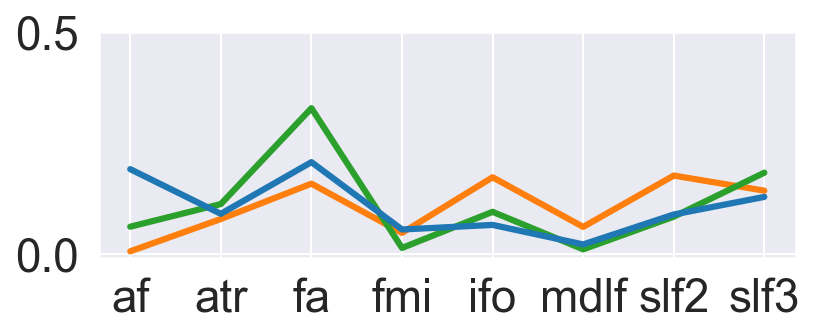

In [32]:
# 5973 in frontal BA45
vert_ind = 5973
hum_bp_ind, neo_bp_ind, neo_surf_ind = get_fingerprint_from_vert(vert_ind, hm, nm, humneo_KL)
hum_bp_ind, mac_bp_ind, mac_surf_ind = get_fingerprint_from_vert(vert_ind, hm, mm, hummac_KL)
print(f'adult = {vert_ind}, neonate = {neo_surf_ind[0]}, macaque = {mac_surf_ind[0]}')

thr = 0.05 # threshold on tract contribution to get top contributors per parcel
tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))

line_plot_3spec(hum_bp_ind, neo_bp_ind, mac_bp_ind)


[5497]
5414
[5497]
5385
adult = 6062, neonate = 6058, macaque = 5998
[0.00328395 0.08896091 0.16764055 0.00624288 0.20508486 0.46744805]


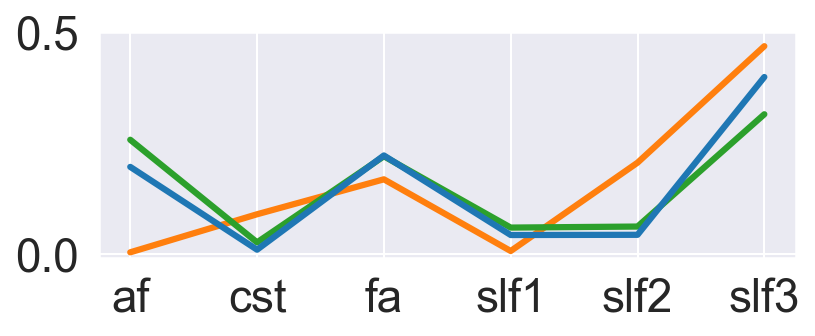

In [33]:
# 6062 in frontal BA44
vert_ind = 6062
hum_bp_ind, neo_bp_ind, neo_surf_ind = get_fingerprint_from_vert(vert_ind, hm, nm, humneo_KL)
hum_bp_ind, mac_bp_ind, mac_surf_ind = get_fingerprint_from_vert(vert_ind, hm, mm, hummac_KL)
print(f'adult = {vert_ind}, neonate = {neo_surf_ind[0]}, macaque = {mac_surf_ind[0]}')

thr = 0.05 # threshold on tract contribution to get top contributors per parcel
tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))

line_plot_3spec(hum_bp_ind, neo_bp_ind, mac_bp_ind)

# neonate = 6058, macaque = 5998

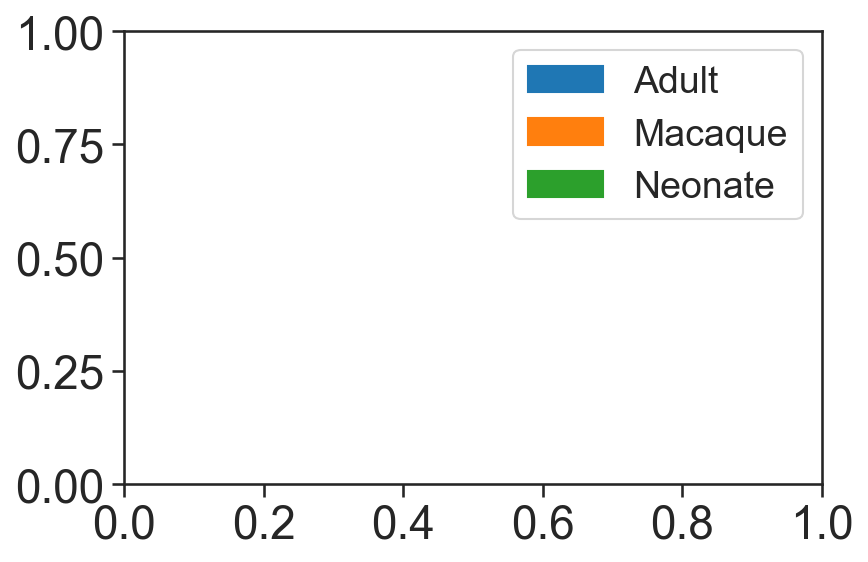

In [35]:
# # # legend for paper figure
# sns.set_style("ticks")
# import matplotlib.patches as mpatches
# ad_patch = mpatches.Patch(color='tab:blue', label='Adult')    
# g1_patch = mpatches.Patch(color='tab:orange', label='Macaque')
# g2_patch = mpatches.Patch(color='tab:green', label='Neonate')  
# plt.legend(handles=[ad_patch, g1_patch, g2_patch], fontsize=18)

## Spectral embedding across ontogeny and phylogeny
### Calculate KL for neonate-adult and macaque-adult
### Spectral reordering of KL divergence matrices and plot
#### Prep data

In [21]:
# Prepare DK adult and neonate data
hum_bp_parc, hum_bp_avparcl, hum_dk_lab_dict, hum_dk_lab_list = prep_dk(hum_parc, hum_bp_forparc)
hum_view_fs_label_dict = abbrv_labs(hum_dk_lab_dict, 'NAME')

neo_bp_parc, neo_bp_avparcl, neo_dk_lab_dict, neo_dk_lab_list = prep_dk(neo_parc, neo_bp_forparc)
neo_view_fs_label_dict = abbrv_labs(neo_dk_lab_dict, 'NAME')

# Prepare BA adult
hum_bp_brod, hum_bp_avbrod, hum_brod_lab_dict, hum_brod_lab_list = prep_ba(hum_brod, hum_bp_forparc)
hum_view_ba_label_dict = abbrv_labs(hum_brod_lab_dict, 'NAME')
data_to_cifti(hum_bp_brod, "{}/brod_blueprint_hum.dscalar.nii".format(results_dir), hum_roi_l, hum_roi_r)

# get BA matched colour-coded DK dict
neo_view_fsba_label_dict = abbrv_labs(custfs_label_dict, 'NAME')

# Prepare BA macaque
mac_bp_forparc = remove_contra(mac_bp, tracts, mac_n_left)
mac_bp_forparc = mac_bp_forparc[:,:mac_n_left]
mac_bp_forparc /= np.sum(mac_bp_forparc, axis=0)

mac_bp_brod, mac_bp_avbrod, mac_brod_lab_dict, mac_brod_lab_list = prep_ba(mac_brod, mac_bp_forparc, mac=True)
mac_brod_lab_dict = abbrv_labs(mac_brod_lab_dict, 'NAME')
data_to_cifti(mac_bp_brod, "{}/brod_blueprint_mac.dscalar.nii".format(results_dir), mac_roi_l)

# add a space to macaque Brodmann names to avoid issues in plotting non-unique entries....
mac_brod_lab_dict['NAME'] += " "

# for summarising into coarse brain "lobes"
brain_regions = np.unique(mac_brod_lab_dict.region.values)

/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


#### Neonate DK and Adult BA - across development and different atlases

Caclulating KL div...
Parcellating...
Embedding...


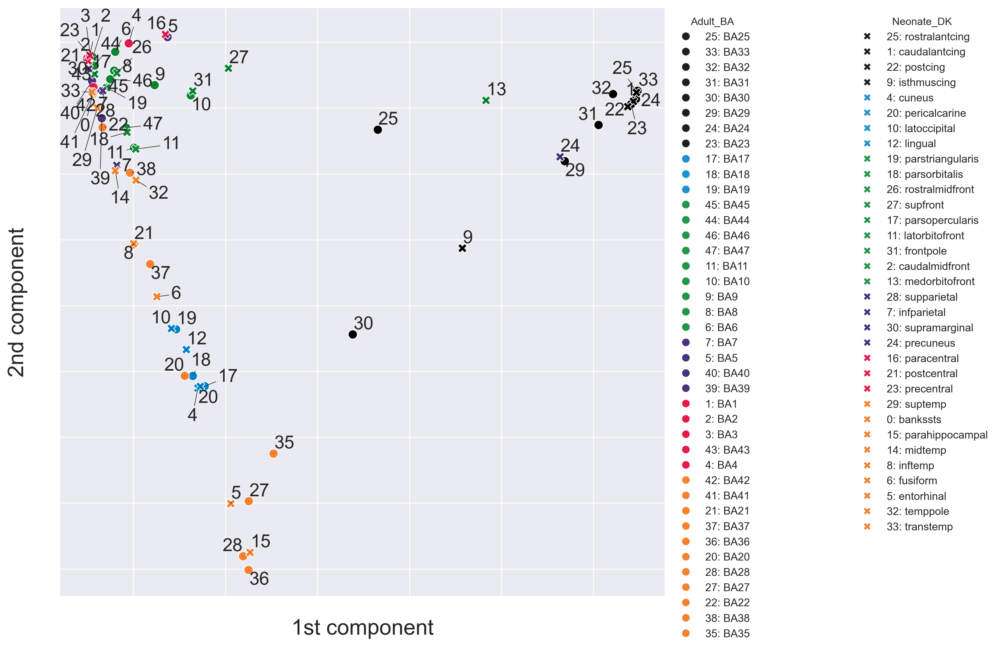

In [167]:
# embedding
P_hn, Q_hn, KL_hn = spectral_embedding(hum_bp_hemi, neo_bp_hemi, ndims=2, 
                       parc1=hum_brod, parc2=neo_parc, 
                          nparc1=hum_bp_avbrod.shape[1], nparc2=neo_bp_avparc.shape[1], 
                          type1='BA', type2='DK')

sns.set_theme()
sns.set_context("paper", rc={"font.size":24,"axes.titlesize":24,"axes.labelsize":20})
xlim_hn, ylim_hn = spec_embed_2Dplot(P_hn, Q_hn, hum_view_ba_label_dict, neo_view_fsba_label_dict, "Adult", "Neonate", "BA", "DK", 0, 1)


#### Adult and Macaque BA - across species but the same type of atlas

Caclulating KL div...
Parcellating...


/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


Embedding...


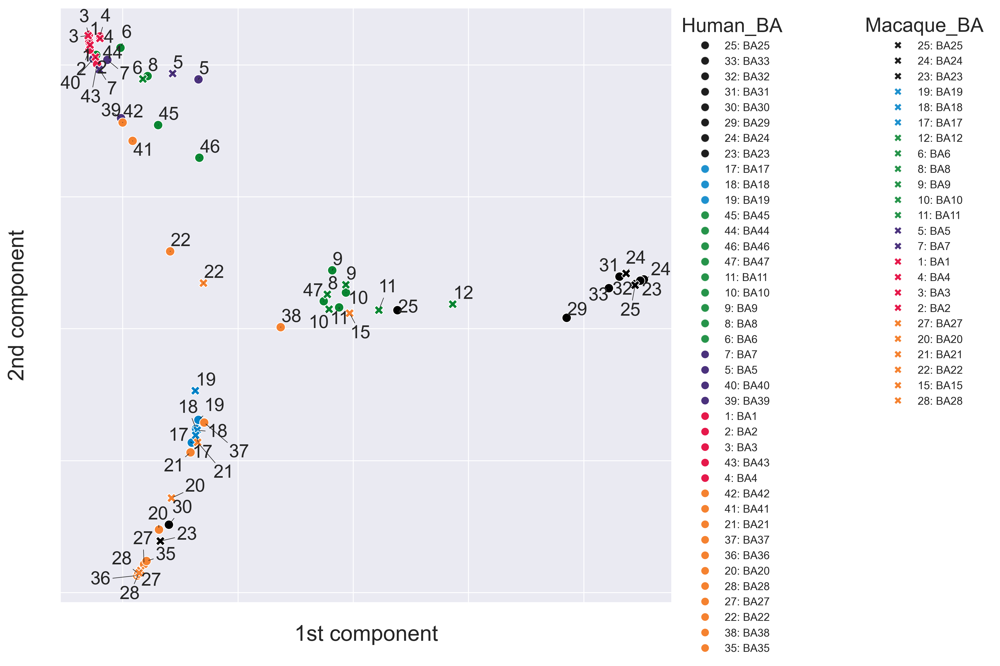

In [168]:
# embedding
P_hm, Q_hm, KL_hm = spectral_embedding(hum_bp_hemi, mac_bp_forparc, ndims=2, 
                       parc1=hum_brod, parc2=mac_brod, 
                          nparc1=hum_bp_avbrod.shape[1], nparc2=mac_bp_avbrod.shape[1], 
                          type1='BA', type2='BA', mac=True)

# rotate to match to human-neonate space
P_hm = np.flip(P_hm, axis=1)
Q_hm = np.flip(Q_hm, axis=1)

xlim_hm, ylim_hm = spec_embed_2Dplot(P_hm, Q_hm, hum_brod_lab_dict, mac_brod_lab_dict, "Human", "Macaque", "BA", "BA ", 0, 1)


#### Plot KL divergence maps

[]

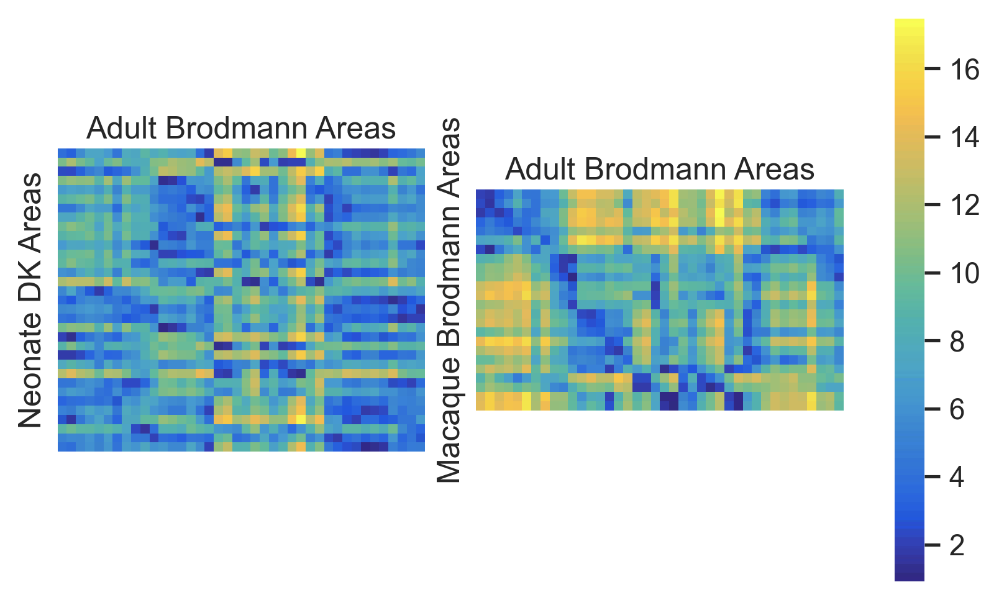

In [169]:
# get colourmap
from matplotlib.image import imread
from matplotlib.colors import LinearSegmentedColormap
img = imread('/Users/shaunwarrington/Documents/baby_xtract/cmap2.png')
my_cmap = img[:, 10, :]
my_cmap = LinearSegmentedColormap.from_list('my_cmap', my_cmap[::-1], N=255)

# plot
sns.set(font_scale=1)
plt.rcParams['figure.dpi'] = 300
f,(ax1, ax2, axcb) = plt.subplots(1, 3, 
            gridspec_kw={'width_ratios':[1, 1, 0.08]})

ax1.get_shared_y_axes().join(ax2)
g1 = sns.heatmap(KL_hn.T, square=True, cmap=my_cmap, cbar=False, ax=ax1)
g1.set_ylabel('Neonate DK Areas')
g1.set_xlabel('Adult Brodmann Areas')
g1.xaxis.set_label_position('top') 
g1.set_yticks([])
g1.set_xticks([])

g2 = sns.heatmap(KL_hm.T, square=True, cmap=my_cmap, ax=ax2, cbar_ax=axcb)
g2.set_ylabel('Macaque Brodmann Areas')
g2.set_xlabel('Adult Brodmann Areas')
g2.xaxis.set_label_position('top') 
g2.set_yticks([])
g2.set_xticks([])


#### COG visualisation

In [170]:
# combine P and Q dims into a single DataFrame
# hum-neo
P_dict_hn = hum_view_ba_label_dict.copy()
P_dict_hn['spect1'] = P_hn[:,0]
P_dict_hn['spect2'] = P_hn[:,1]

Q_dict_hn = custfs_label_dict.copy()
Q_dict_hn['spect1'] = Q_hn[:,0]
Q_dict_hn['spect2'] = Q_hn[:,1]

# hum-mac
P_dict_hm = hum_view_ba_label_dict.copy()
P_dict_hm['spect1'] = P_hm[:,0]
P_dict_hm['spect2'] = P_hm[:,1]

Q_dict_hm = mac_brod_lab_dict.copy()
Q_dict_hm['spect1'] = Q_hm[:,0]
Q_dict_hm['spect2'] = Q_hm[:,1]


In [230]:
# get region-wise COG and Euclidean distance between corresponding pairs
# input is pd.DataFrames containing embedded dimensions (P and Q), parcel labels and regions to which they belong
def region_cog(P_dict, Q_dict, brain_regions, name1, name2, xlim, ylim):
    stats_P = P_dict.groupby('region').describe()
    stats_Q = Q_dict.groupby('region').describe()
    
    ### calculate Euclidean distance and plot
    nr = len(brain_regions)
    euc_dict_mat = np.zeros((nr, nr))
    # between each lobe pair
    for ind1,reg,i,j in zip(range(nr), stats_P.index, stats_P.spect1['mean'], stats_P.spect2['mean']):
        for ind2,x,y in zip(range(nr), stats_Q.spect1['mean'], stats_Q.spect2['mean']):    
            euc_dict_mat[ind1,ind2] = np.linalg.norm(np.array([i,j]) - np.array([x,y]))
    
    euc_dist = np.diag(euc_dict_mat)
    
    ### plot COG with measure of uncertianty
    # create DataFrames containing COG coordinates and region names
    P_cog = pd.DataFrame({"region": stats_P.index, "spec": name1, 
                          "dim1": stats_P.spect1['50%'], "dim2": stats_P.spect2['50%']})
    Q_cog = pd.DataFrame({"region": stats_Q.index, "spec": name2,
                          "dim1": stats_Q.spect1['50%'], "dim2": stats_Q.spect2['50%']})   
    
    cog = pd.concat([P_cog, Q_cog])
    rgba_list = []
    for i, row in cog.iterrows():
        rgba_list.append(P_dict[P_dict.region == row.region].RGBA.values[0])
    
    cog["RGBA"] = rgba_list
    
    # plot
    sns.set_style("white")
    fig, ax = plt.subplots(figsize=(3, 3), dpi=300)
    
    # create seaborn colour palette from RGBA values
    sns.set_palette(sns.color_palette(cog.RGBA.values, n_colors=cog.shape[0]), n_colors=cog.shape[0])
    ax = sns.scatterplot(data=cog, x="dim1", y="dim2", hue="region", hue_order=brain_regions,
                         style="spec", s=250, markers={name1: 'o', name2: 'X'}, legend = False, 
                        linewidth=0.5)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('1st comp.', fontsize=20)
    plt.ylabel('2nd comp.', fontsize=20)
    plt.xlim(xlim)
    plt.ylim(ylim)
    sns.despine()
    ax.spines['left'].set_linewidth(3)
    ax.spines['bottom'].set_linewidth(3)
    ax.spines['right'].set_linewidth(3)
    ax.spines['top'].set_linewidth(3)
    plt.savefig(f'/Users/shaunwarrington/Downloads/{name1}_{name2}.png', transparent=False)
    
    return cog, euc_dist


In [231]:
print(f'{xlim_hn} {ylim_hn}')
print(f'{xlim_hm} {ylim_hm}')

(-0.18004302236053718, 0.47782098799491746) (-0.6421358896602546, 0.252507592020017)
(-0.3079592748588517, 0.7527264728119231) (-0.4153337004764778, 0.4866078975718523)


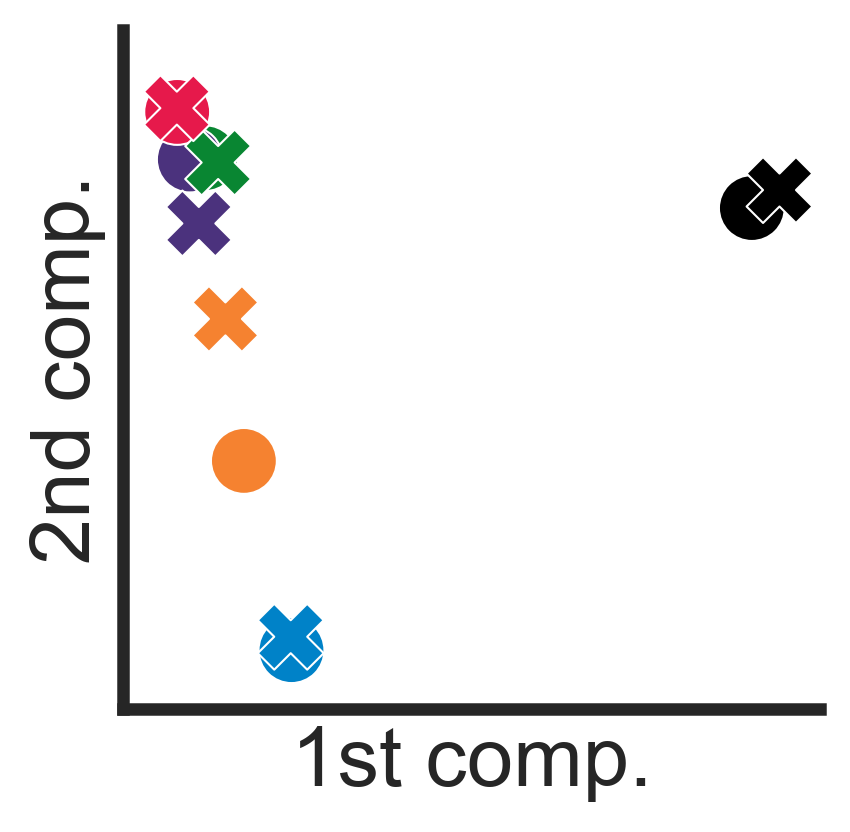

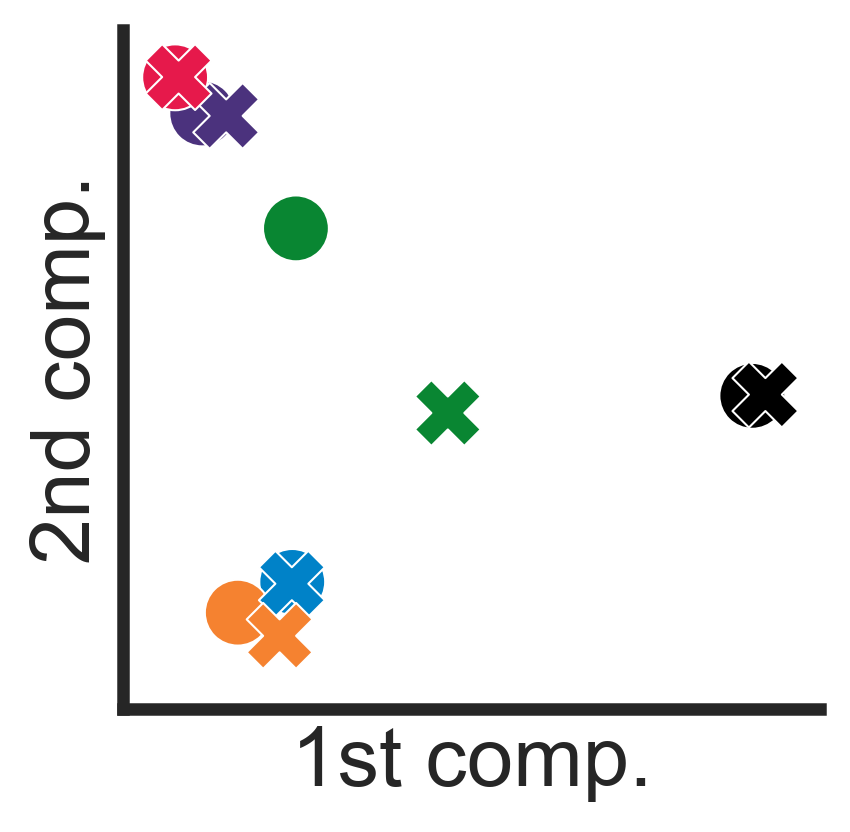

In [234]:
cog_hn, euc_dict_hn = region_cog(P_dict_hn, Q_dict_hn, brain_regions, 
                                 'Adult', 'Neonate', [-0.2, 0.48], [-0.36, 0.25])

cog_hm, euc_dict_hm = region_cog(P_dict_hm, Q_dict_hm, brain_regions, 
                                 'Human', 'Macaque', [-0.34, 0.76], [-0.3, 0.49])


## KL divergence in preterms vs full-terms
### Same as with KL vs age: load each group, get KL, plot

In [21]:
# dense
groups = ["preterm", "preterm_match"]
dense_labels = dense_parc_labels(neo_parc)
df = pd.DataFrame()
df_parc = pd.DataFrame()
# dense
for group in groups:
    print(group)
    group_bp = load_age_bp(group)
    if group == "preterm":
        prem_bp_hemi = np.copy(group_bp)
    elif group == "preterm_match":
        term_bp_hemi = np.copy(group_bp)
    
    # neo 2 hum
    D = KLD(group_bp.T, hum_bp_hemi.T)
    D[D == 0] = np.nan

    min_KLD = np.nanmin(D, axis=1) 
    data_to_cifti(min_KLD, f"{results_dir}/{group}_hum_minKLD.dscalar.nii", neo_roi_l, neo_roi_r)
    
    group_df = pd.DataFrame({"Group":group, 
                            "Min KLD": min_KLD,
                            "Parcel": dense_labels})
    df = df.append(group_df, ignore_index=True)
    
    # parcellate the KL matrix and get the KL divergence between corresponding parcels
    D_parc = parcellate_KLmat(group_bp, hum_bp_hemi, D, parc1=neo_parc, parc2=hum_parc, 
                     nparc1=hum_bp_avparc.shape[1], nparc2=neo_bp_avparc.shape[1], type1='DK', type2='DK')
    neo2hum_cross_parc_KLD = np.diag(D_parc)
    
    data_to_cifti(return_parc_data(neo_parc, neo2hum_cross_parc_KLD, neo_dk_lab_list), 
                  f"{results_dir}/{group}_hum_KLD_parc.dscalar.nii", neo_roi_l, neo_roi_r)
    data_to_cifti(return_parc_data(hum_parc, neo2hum_cross_parc_KLD, neo_dk_lab_list), 
                  f"{results_dir}/hum_{group}_KLD_parc.dscalar.nii", hum_roi_l, hum_roi_r)   

    for i, parc in enumerate(neo_dk_lab_list):
        df_parc = df_parc.append({
            "Parcel":parc,
            "Group":group,
            "KLD":neo2hum_cross_parc_KLD[i]
        }, ignore_index=True)

# remove entries for parcels we are removing
df = df.drop(df[~df.Parcel.isin(fs_label_dict.NAME.values)].index)
df_parc = df_parc.drop(df_parc[~df_parc.Parcel.isin(fs_label_dict.NAME.values)].index)

# rename labels
df = abbrv_labs(df, 'Parcel')
df_parc = abbrv_labs(df_parc, 'Parcel')

df_term = df[df.Group == 'preterm_match']
df_preterm = df[df.Group == 'preterm']

df_parc_term = df_parc[df_parc.Group == 'preterm_match']
df_parc_preterm = df_parc[df_parc.Group == 'preterm']

/usr/local/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


preterm


<ipython-input-21-74660194cd17>:22: RuntimeWarning: All-NaN slice encountered
  min_KLD = np.nanmin(D, axis=1)
<ipython-input-21-74660194cd17>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(group_df, ignore_index=True)
/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
<ipython-input-21-74660194cd17>:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_parc = df_parc.append({
<ipython-input-21-74660194cd17>:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a f

preterm_match


<ipython-input-21-74660194cd17>:22: RuntimeWarning: All-NaN slice encountered
  min_KLD = np.nanmin(D, axis=1)
<ipython-input-21-74660194cd17>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(group_df, ignore_index=True)
/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
<ipython-input-21-74660194cd17>:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_parc = df_parc.append({
<ipython-input-21-74660194cd17>:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a f

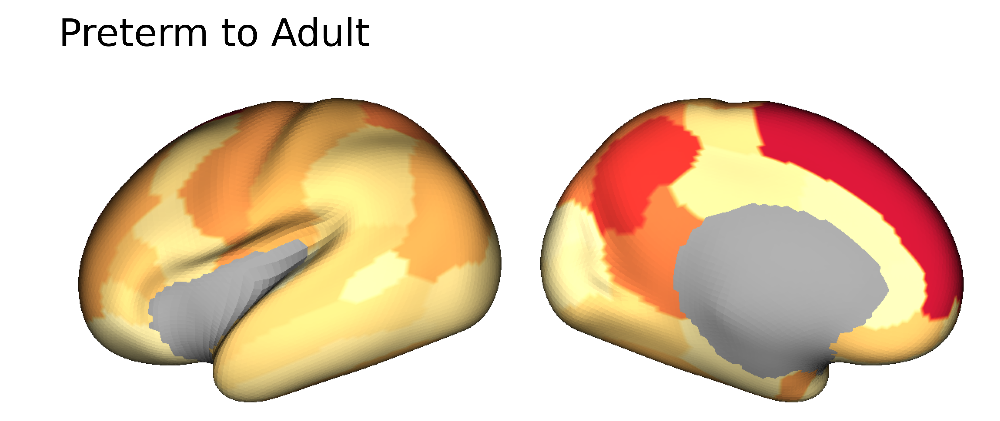

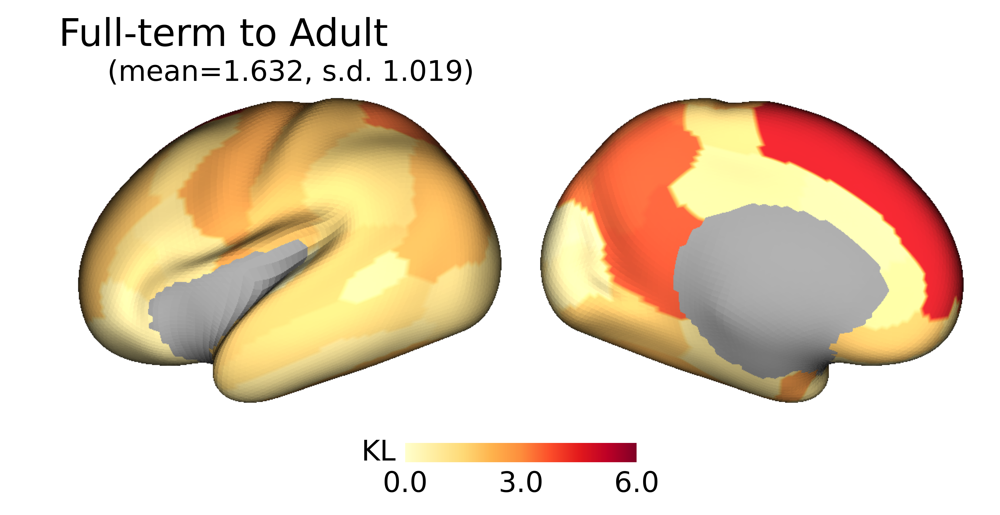

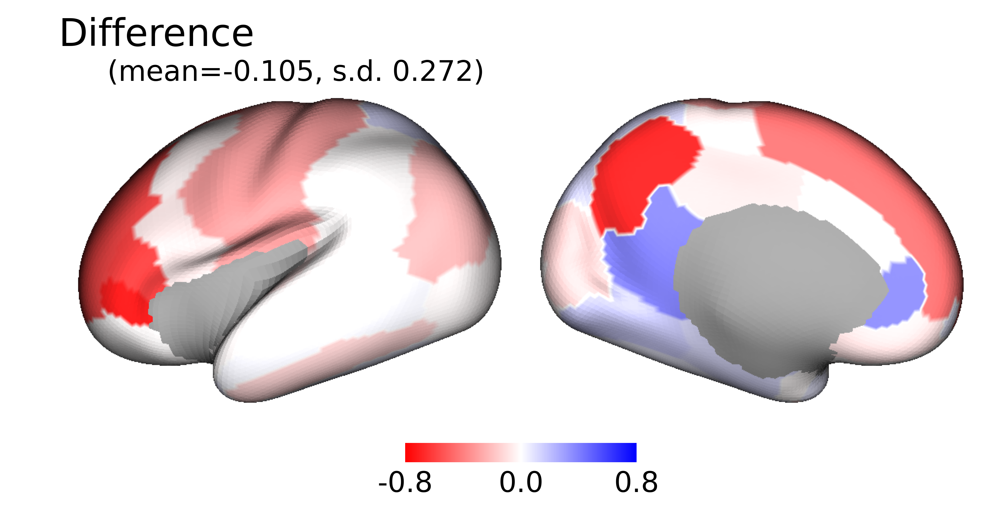

In [23]:
# difference between parcellated maps on adult surface
prem_minKL = nib.load(f"{results_dir}/preterm_hum_KLD_parc.dscalar.nii")
prem_minKL = np.asanyarray(prem_minKL.dataobj)

term_minKL = nib.load(f"{results_dir}/preterm_match_hum_KLD_parc.dscalar.nii")
term_minKL = np.asanyarray(term_minKL.dataobj)

difference_parc = term_minKL - prem_minKL
data_to_cifti(difference_parc, f"{results_dir}/premterm_hum_diff_parc.dscalar.nii", neo_roi_l, neo_roi_r)

df_stats = df_parc.groupby('Group')["KLD"].describe()

# plot surfaces
# pre-term to adult
mn = df_stats.loc["preterm"]['mean']
mn = f'{mn:.3f}'
sd = df_stats.loc["preterm"]['std']
sd = f'{sd:.3f}'
plot_surf(f'{results_dir}/preterm_hum_KLD_parc.dscalar.nii', 
           f'{surf_dir}/L.rneo.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rneo.very_inflated.resampled.surf.gii',
           neo_roi_l, neo_roi_r, 'YlOrRd', [0, 6], 'Preterm to Adult', cbar=False, mean=mn, sd=sd)

# full-term to adult
mn = df_stats.loc["preterm_match"]['mean']
mn = f'{mn:.3f}'
sd = df_stats.loc["preterm_match"]['std']
sd = f'{sd:.3f}'
plot_surf(f'{results_dir}/preterm_match_hum_KLD_parc.dscalar.nii', 
           f'{surf_dir}/L.rneo.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rneo.very_inflated.resampled.surf.gii',
           neo_roi_l, neo_roi_r, 'YlOrRd', [0, 6], 'Full-term to Adult', cbar_title="KL", mean=mn, sd=sd)

# difference map
mn = f'{np.nanmean(df_parc_term["KLD"].values - df_parc_preterm["KLD"].values):.3f}'
sd = f'{np.nanstd(df_parc_term["KLD"].values - df_parc_preterm["KLD"].values):.3f}'
plot_surf(f'{results_dir}/premterm_hum_diff_parc.dscalar.nii', 
           f'{surf_dir}/L.rneo.very_inflated.resampled.surf.gii', 
           f'{surf_dir}/R.rneo.very_inflated.resampled.surf.gii',
           neo_roi_l, neo_roi_r, 'bwr_r', [-0.8, 0.8], 'Difference', cbar_title="", mean=mn, sd=sd)



In [24]:
# some stats
print(scipy.stats.ttest_ind(df_parc_term["KLD"].values, df_parc_preterm["KLD"].values, nan_policy='omit'))

difference = df_parc_term["KLD"].values - df_parc_preterm["KLD"].values
print(np.nanmean(difference))
print(scipy.stats.ttest_1samp(difference, popmean=0, nan_policy='omit'))


Ttest_indResult(statistic=-0.4033468365196851, pvalue=0.6880374953125614)
-0.10492517408877554
Ttest_1sampResult(statistic=-2.1793781263053673, pvalue=0.03677604956875282)


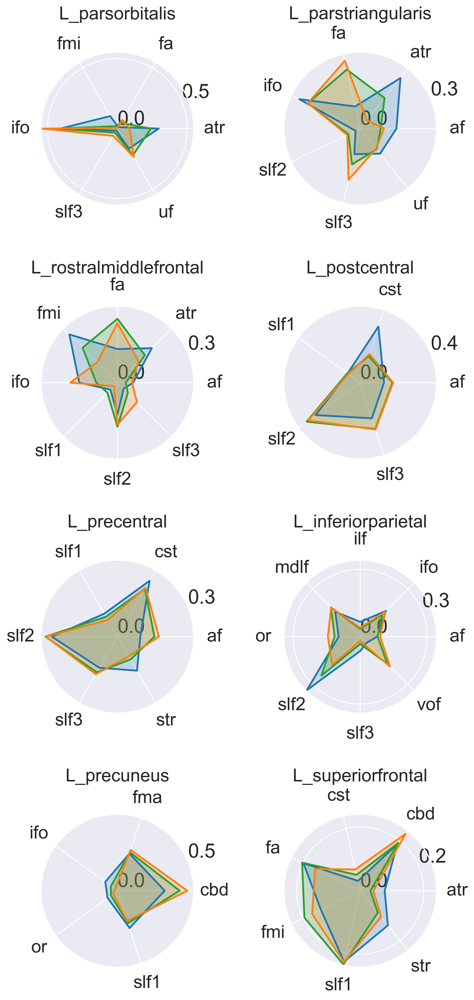

In [34]:
thr = 0.05 # threshold on tract contribution to get top contributors per parcel
tract_names = sorted(list(set([ x.split("_")[0] for x in tracts ])))

# parcels to include
labels = ["L_parsorbitalis", "L_parstriangularis", "L_rostralmiddlefrontal", "L_postcentral",
         "L_precentral", "L_inferiorparietal", "L_precuneus", "L_superiorfrontal"]

# labels = ["L_parsorbitalis", "L_parstriangularis", "L_precuneus", "L_superiorfrontal", "L_postcentral", "L_precentral"]

n_labs = len(labels)

temp_dict = fs_label_dict.copy()
temp_dict.reset_index(inplace=True)

plt.rcParams['figure.dpi'] = 300
sns.set_theme()
sns.set(font_scale=2)

k = 2 # how many columns
m = int(np.ceil(len(labels)/k)) # how many rows
fig, ax = plt.subplots(m, k, subplot_kw=dict(projection='polar'), figsize=(k*4, m*4))

# Load age group data
group_bp1 = load_age_bp(groups[0])
group_bp2 = load_age_bp(groups[1])

n = 0
for j in range(m):
    for i in range(k):
        if n < n_labs:
            ii = temp_dict.index[temp_dict['NAME'] == labels[n]][0]
            
            # get parcel connectivity profiles
            hum = get_parc_profile(hum_parc, hum_bp_hemi, labels[n])
            group1 = get_parc_profile(neo_parc, group_bp1, labels[n])
            group2 = get_parc_profile(neo_parc, group_bp2, labels[n])
            
            # get index of tracts to include (top tracts from each brain)
            ind = np.argwhere(group1[:]>thr)
            grot_ind = np.argwhere(group2[:]>thr)
            ind = np.unique(np.append(ind, grot_ind))          
            grot_ind = np.argwhere(hum[:]>thr)
            ind = np.unique(np.append(ind, grot_ind))
            
            grot_lab = [tract_names[s] for s in ind]
            
            theta = np.linspace(0, 2 * np.pi, len(grot_lab), endpoint=False)
            
            # and plot
            def plot_radar(data, theta, label, color):
                pline = [*data, data[0]]
                thetaline = [*theta, theta[0]]
                ax[j,i].plot(thetaline, pline, linewidth=2, color=color, label=label)
                ax[j,i].fill(thetaline, pline, color, alpha=0.2, label=label)               
            
            hum = hum[ind]/np.sum(hum[ind])
            group2 = group2[ind]/np.sum(group2[ind])
            group1 = group1[ind]/np.sum(group1[ind])
            
            vmax = np.max((np.max(hum), 
               np.max(group1), 
               np.max(group2)
              ))*1.01
            
            # adult
            plot_radar(hum, theta, "adult", "tab:blue")
            # group2
            plot_radar(group2, theta, groups[1], "tab:green")   
            # group1
            plot_radar(group1, theta, groups[0], "tab:orange")     
                       
            ax[j,i].set_title(f'{labels[n]}', size=20, y=1.18)
            ax[j,i].set_rlim(bottom=0, top=vmax)
            ax[j,i].set_rticks([0, np.round(vmax,1)])
            ax[j,i].set_xticks(theta)
            ax[j,i].set_xticklabels(grot_lab, fontdict={'fontsize':20})
            ax[j,i].tick_params(axis='x', which='major', pad=10)

        if n >= n_labs:
            ax[j,i].set_rticks([0, 0])
        n += 1
        
fig.tight_layout()

In [35]:
# # legend for paper figure
# sns.set_style("ticks")
# import matplotlib.patches as mpatches
# ad_patch = mpatches.Patch(color='tab:blue', label='Adult (reference)')    
# g1_patch = mpatches.Patch(color='tab:orange', label='Preterm')
# g2_patch = mpatches.Patch(color='tab:green', label='Full-term')  
# plt.legend(handles=[ad_patch, g1_patch, g2_patch], fontsize=18)
